In [14]:
import anndata
import pixelator
import torch
import scvi
import scipy
# from scvi import autotune

import seaborn as sns
import scanpy as sc
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from tqdm import tqdm

from scib_metrics.benchmark import Benchmarker, BioConservation, BatchCorrection

# import ray
# from ray import tune


from PixelGen.pxl_utils import *
from PixelGen.scvi_utils import plot_losses
from PixelGen.tests import test_convert_edgelist_to_protein_pair_colocalization

from pixelator.plot import molecule_rank_plot, cell_count_plot, scatter_umi_per_upia_vs_tau
from pixelator.statistics import clr_transformation
from pixelator.analysis.normalization import dsb_normalize

from scipy.sparse.csgraph import dijkstra
import hotspot

import tempfile

from scvi import REGISTRY_KEYS
from scvi.module.base import (
    BaseModuleClass,
    LossOutput,
    PyroBaseModuleClass,
    auto_move_data,
)
from torch.distributions import NegativeBinomial, Normal, Poisson
from torch.distributions import kl_divergence as kl

from PixelGen.modules import MultiModalSCVI

print(torch.cuda.is_available())

%load_ext autoreload
%autoreload 2

scvi.settings.seed = 0
print("Last run with scvi-tools version:", scvi.__version__)
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"

Seed set to 0


True
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Last run with scvi-tools version: 1.2.2.post2


In [2]:
DATA_DIR = Path('./PixelGen/datasets')


FILENAMES = [
    "Uropod_CD54_fixed.layout.dataset.pxl",
    "Uropod_CD54_fixed_RANTES_stimulated.layout.dataset.pxl",
    "Uropod_CD54_fixed_MCP1_stimulated.layout.dataset.pxl",
    "Uropod_control.layout.dataset.pxl",
    "Uropod_control_RANTES_stimulated.layout.dataset.pxl",
    "Uropod_control_MCP1_stimulated.layout.dataset.pxl",
]

SAMPLE_NAMES = [
    "imm_no_cytokine", 
    "imm_rantes",
    "imm_mcp1", 
    "sol_no_cytokine",
    "sol_rantes",
    "sol_mcp1"
]

# COMBINED_FILENAME = "combined_resting_data.pxl"

COMBINED_FILENAME = "uropod_combined.pxl"
COMBINED_PROCESSED_NAME = "uropod_combined_PROCESSED.pxl"

combined_path = DATA_DIR / COMBINED_FILENAME

# pg_data = pixelator.read(DATA_DIR / COMBINED_PROCESSED_NAME)
# adata = pg_data.adata

if os.path.exists(combined_path):
    pg_data = pixelator.read(combined_path)
else:
    
    baseurl = "https://pixelgen-technologies-datasets.s3.eu-north-1.amazonaws.com/mpx-datasets/pixelator/0.18.x/uropod-t-cells-v1.0-immunology-I"
    for filename in FILENAMES:
        !curl -L -O -C - --create-dirs --output-dir {DATA_DIR} {baseurl}/{filename}

    datasets = [pixelator.read(DATA_DIR / filename) for filename in FILENAMES]
    pg_data = pixelator.simple_aggregate(
        SAMPLE_NAMES, datasets
    )
    pg_data.save(combined_path, force_overwrite=True)

In [15]:
adata = pg_data.adata.copy()
adata.raw = adata.copy()
sc.pp.calculate_qc_metrics(adata, percent_top=None, inplace=True, var_type='proteins')
adata.layers['counts'] = adata.X.copy()

/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing read_elem from `anndata.experimental` is deprecated. Import anndata.io.read_elem instead.
  warnings.warn(msg, FutureWarning)


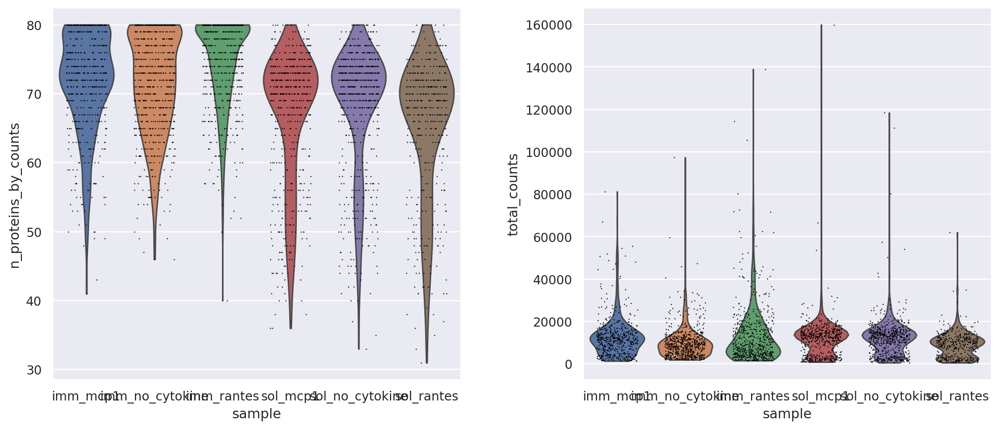

In [16]:
sc.pl.violin(
    adata,
    ["n_proteins_by_counts", "total_counts",],
    groupby='sample',
    jitter=0.3,
    multi_panel=True,
)

/tmp/ipykernel_1870173/3289861945.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  molecule_rank_df["rank"] = molecule_rank_df.groupby(["sample"])["molecules"].rank(
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/pixelator/plot/__init__.py:133: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  edge_rank_df["rank"] = edge_rank_df.groupby([group_by])["molecules"].rank(


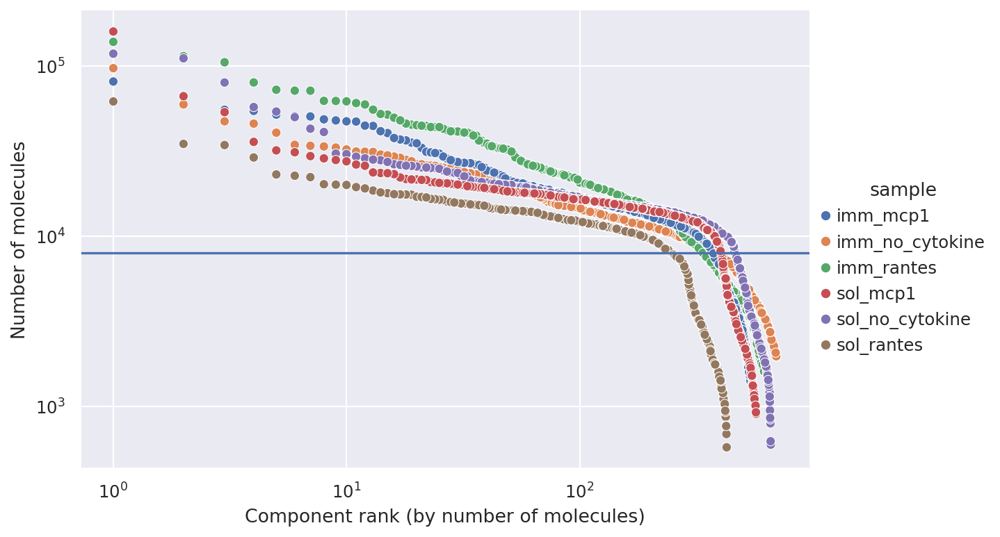

In [17]:
molecule_rank_df = adata.obs[["sample", "molecules"]].copy()
molecule_rank_df["rank"] = molecule_rank_df.groupby(["sample"])["molecules"].rank(
    ascending=False, method="first"
)
fig_intersection, ax = molecule_rank_plot(molecule_rank_df, group_by="sample")
ax.axhline(y=8000)

/tmp/ipykernel_1870173/61645433.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/pixelator/plot/__init__.py:271: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_data = data.groupby(color_by).size().reset_index(name="n")


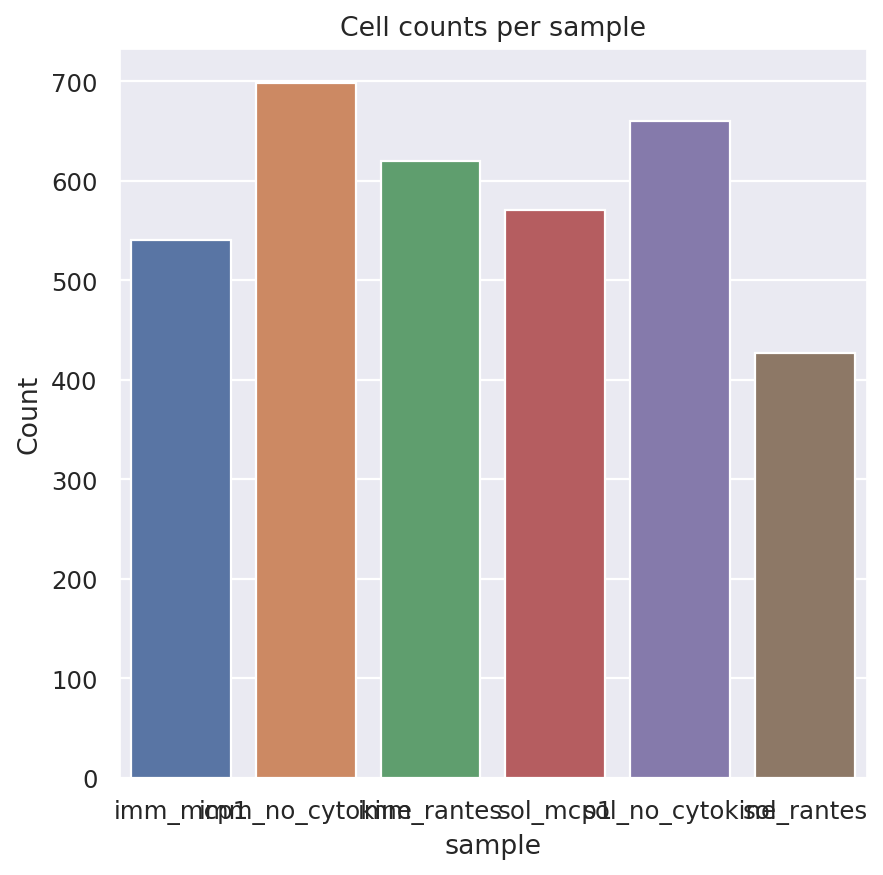

In [18]:
cells_per_sample_df = (
    adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
)

fig, ax = cell_count_plot(adata.obs, color_by="sample")

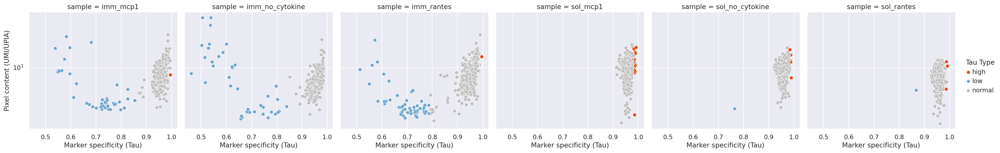

In [19]:
tau_metrics_df = adata.obs[["sample", "tau", "mean_molecules_per_a_pixel", "tau_type"]]
tau_metrics_df = tau_metrics_df.rename(columns={"mean_molecules_per_a_pixel": "umi_per_upia"})


fig, ax = scatter_umi_per_upia_vs_tau(tau_metrics_df, group_by="sample")

/tmp/ipykernel_1870173/839017279.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/pixelator/plot/__init__.py:271: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_data = data.groupby(color_by).size().reset_index(name="n")


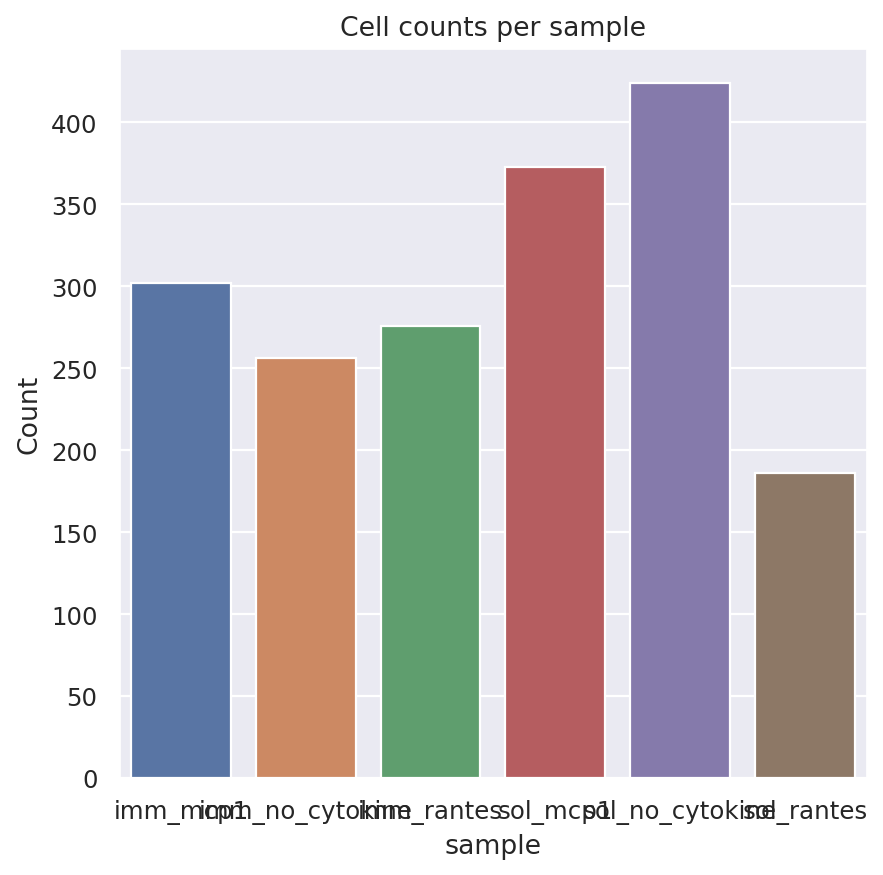

In [20]:
components = adata.obs[
    (adata.obs['tau_type'] == 'normal') & 
    (adata.obs['molecules'] > 10000)
].index
orig_adata = adata.copy()
adata = orig_adata[components, :]
cells_per_sample_df = (
    adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
)

fig, ax = cell_count_plot(adata.obs, color_by="sample")

/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


[]

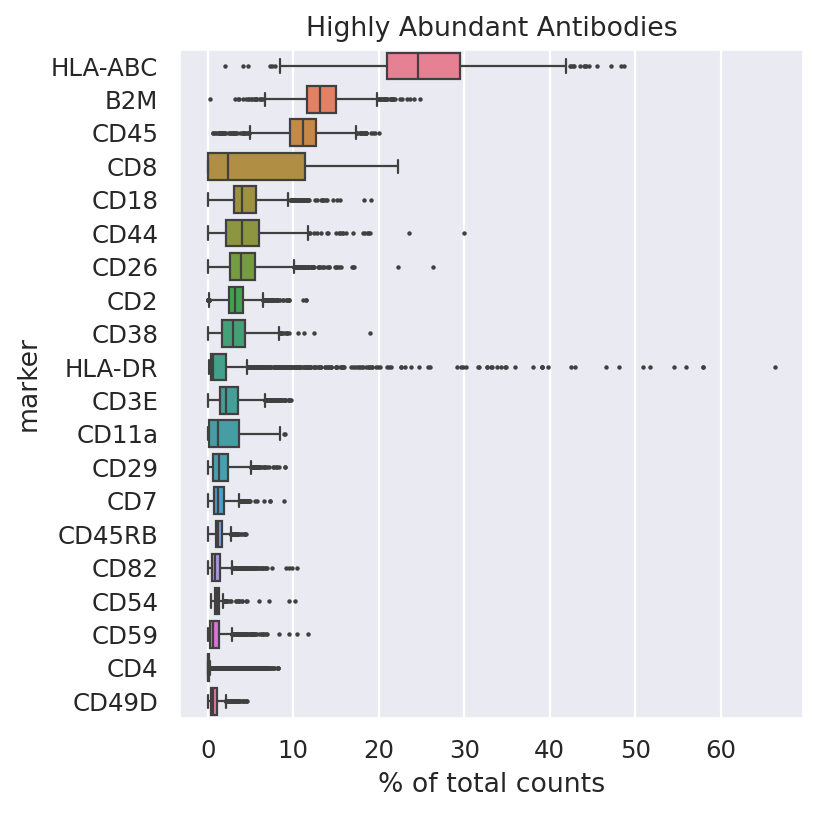

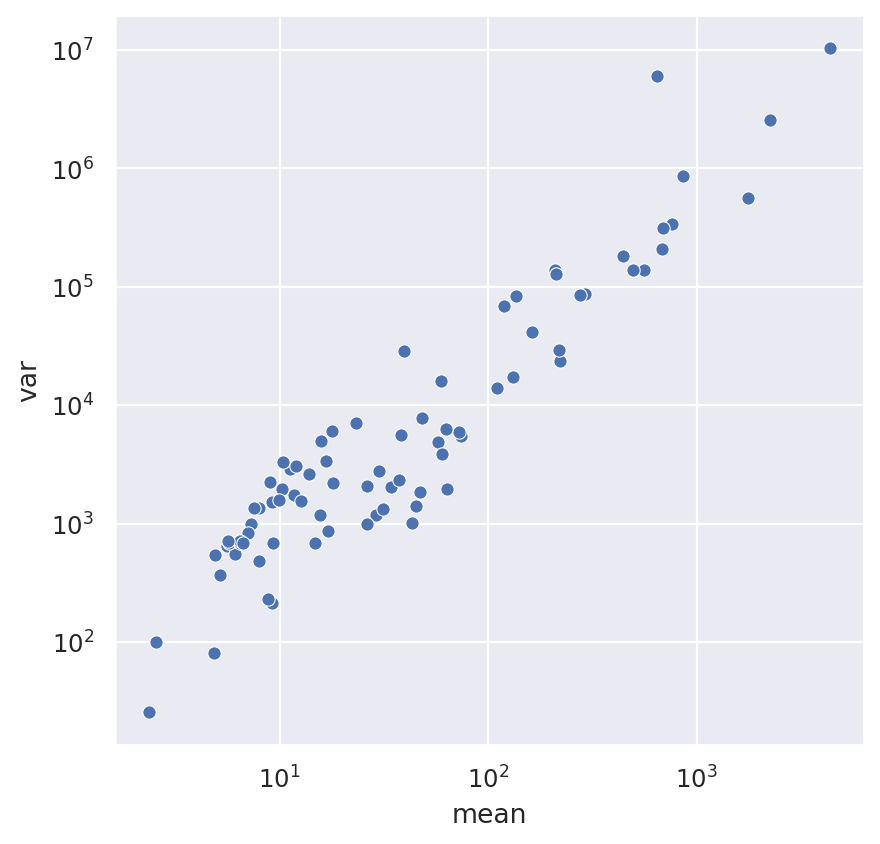

In [21]:
ax = sc.pl.highest_expr_genes(adata, n_top=20, show=False)
ax.set_title('Highly Abundant Antibodies')
stats = adata.to_df().agg(['mean', 'var',], axis=0).T
fig, ax = plt.subplots(1)
sns.scatterplot(x=stats['mean'], y=stats['var'], ax=ax)
ax.loglog()
# var_genes = sc.pp.highly_variable_genes(adata, flavor='seurat_v3', n_top_genes=20, batch_key='sample', layer='counts', inplace=False)
# sc.pl.highly_variable_genes(var_genes, show=True, log=True)

In [22]:
# components = adata.obs[adata.obs['sample'].isin(['imm_rantes', 'sol_rantes'])].index
# adata = adata[components, :]

In [3]:
adata.obs['condition'] = ['sol' if 'sol' in sample else 'imm' for sample in adata.obs['sample']]

NameError: name 'adata' is not defined

In [ ]:
isotype_controls=['mIgG1', 'mIgG2a', 'mIgG2b']
non_isotype_vars = [var for var in adata.var_names if var not in isotype_controls]

In [ ]:
adata.layers['dsb'] = dsb_normalize(adata.to_df('counts'), isotype_controls=isotype_controls)
adata.layers['clr_by_cell'] = clr_transformation(adata.to_df('counts'), axis=1)
adata.layers['clr_by_ab'] = clr_transformation(adata.to_df('counts'), axis=0)
adata.layers['log1p'] = np.log1p(adata.to_df('counts'))

<Axes: title={'center': 'Cumulative Variance Explained'}>

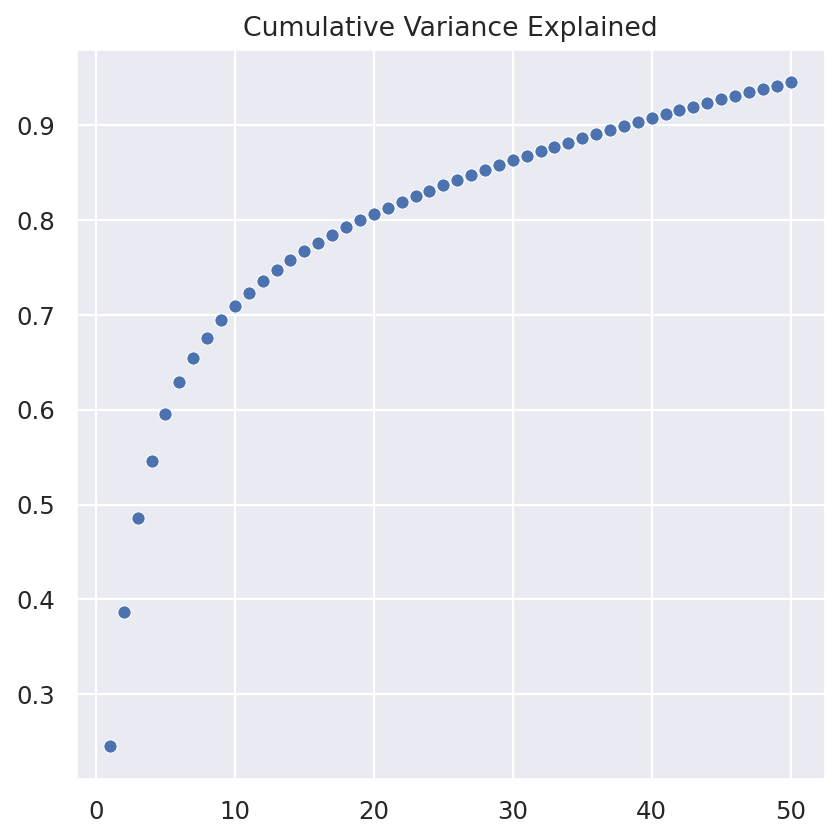

In [25]:
sc.tl.pca(adata, layer='dsb')
plot_cumulative_variance(adata)

/tmp/ipykernel_1870173/1873555562.py:3: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata)


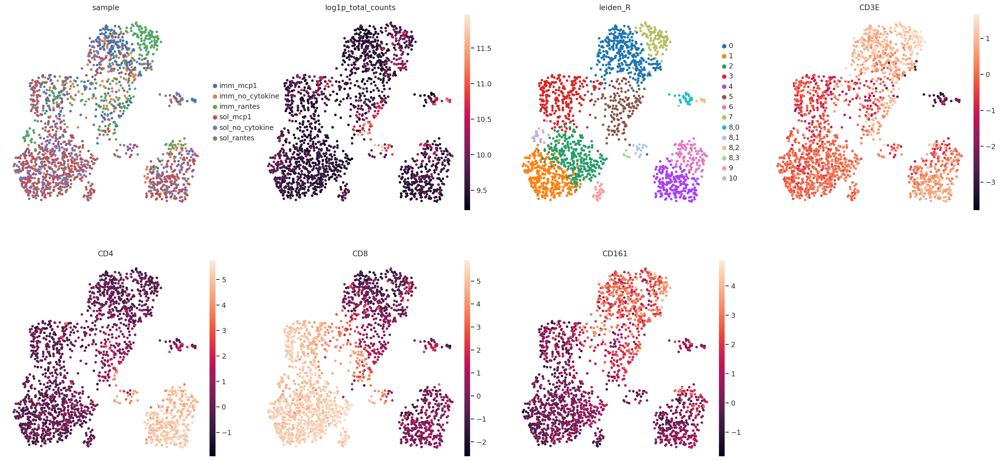

In [26]:
sc.pp.neighbors(adata,)
sc.tl.umap(adata, )
sc.tl.leiden(adata)
sc.tl.leiden(adata, restrict_to=('leiden', ['8']), resolution=0.5)
sc.pl.umap(adata, layer='dsb', color=['sample', 'log1p_total_counts', 'leiden_R', 'CD3E', 'CD4', 'CD8', 'CD161',])

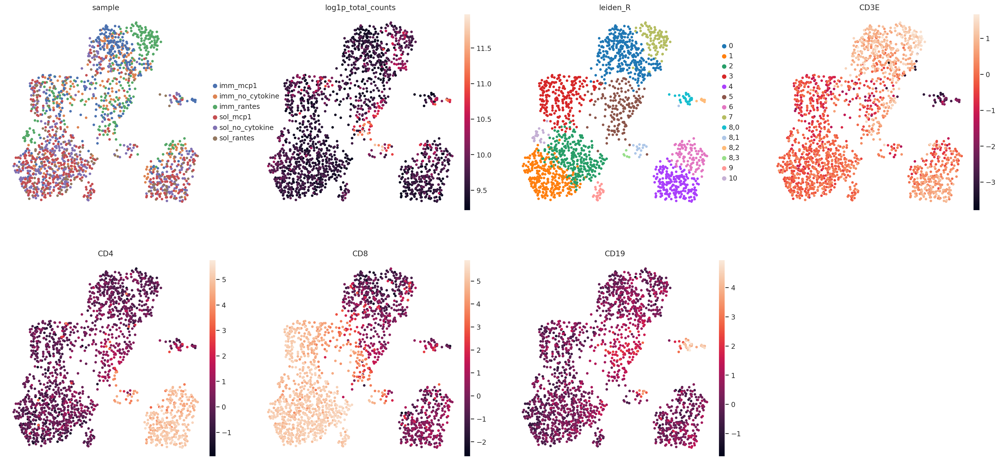

In [27]:
sc.pl.umap(adata, layer='dsb', color=['sample', 'log1p_total_counts', 'leiden_R', 'CD3E', 'CD4', 'CD8', 'CD19',])

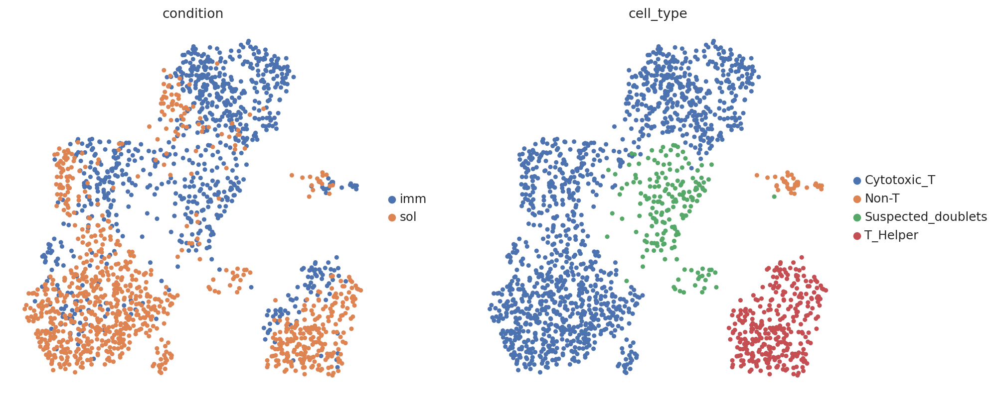

In [28]:
cell_type_dict = {'0': 'Cytotoxic_T', '7': 'Cytotoxic_T', '5': 'Suspected_doublets', '1': 'Cytotoxic_T', '2':'Cytotoxic_T', '3':'Cytotoxic_T', '9': 'Cytotoxic_T', 
                  '10': 'Cytotoxic_T', '8,1': 'Suspected_doublets', '8,3': 'Suspected_doublets', '8,0': 'Non-T', '8,2': 'Non-T', '4': 'T_Helper', '6':'T_Helper',
                  }
adata.obs['cell_type'] = adata.obs['leiden_R'].map(cell_type_dict)
sc.pl.umap(adata,  color=['condition', 'cell_type',])

In [29]:
vars = [v for v in adata.var_names if v not in ['mIgG1', 'mIgG2a', 'mIgG2b']]

polarization_i = convert_polarization_to_feature_matrix(pg_data.polarization, components=adata.obs.index, key='morans_i', vars=vars)
polarization_z = convert_polarization_to_feature_matrix(pg_data.polarization, components=adata.obs.index, key='morans_z', vars=vars)

coloc_p = convert_colocalization_to_feature_matrix(pg_data.colocalization, components=adata.obs.index, key='pearson', vars=vars)
coloc_z = convert_colocalization_to_feature_matrix(pg_data.colocalization, components=adata.obs.index, key='pearson_z', vars=vars)
adata.obsm['pol_i'] = polarization_i
adata.obsm['pol_z'] = polarization_z
adata.obsm['coloc_p'] = coloc_p
adata.obsm['coloc_z'] = coloc_z


In [40]:
from pathlib import Path

DATASET_DIR = Path('PixelGen/datasets')
# adata.write_h5ad(DATASET_DIR / 'uropod_combined_annotated_with_pol.h5ad')
# adata = anndata.read_h5ad(DATASET_DIR / 'uropod_combined_annotated_with_pol.h5ad')
adata = anndata.read_h5ad(DATASET_DIR / 'uropod_hs_10.h5ad')

In [41]:
isotype_controls=['mIgG1', 'mIgG2a', 'mIgG2b']
non_isotype_vars = [var for var in adata.var_names if var not in isotype_controls]

adata = adata[adata.obs[adata.obs['cell_type'] != 'Suspected_doublets'].index,:].copy()
print(adata.obs['cell_type'].unique())

['T_Helper', 'Cytotoxic_T', 'Non-T']
Categories (3, object): ['Cytotoxic_T', 'Non-T', 'T_Helper']


/tmp/ipykernel_2067763/1614539879.py:1: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pol_hs_pivot = adata.uns['pol_hs_10'].pivot_table(index='component', columns='marker', values='hs_pol', fill_value=0).reindex(adata.obs.index)


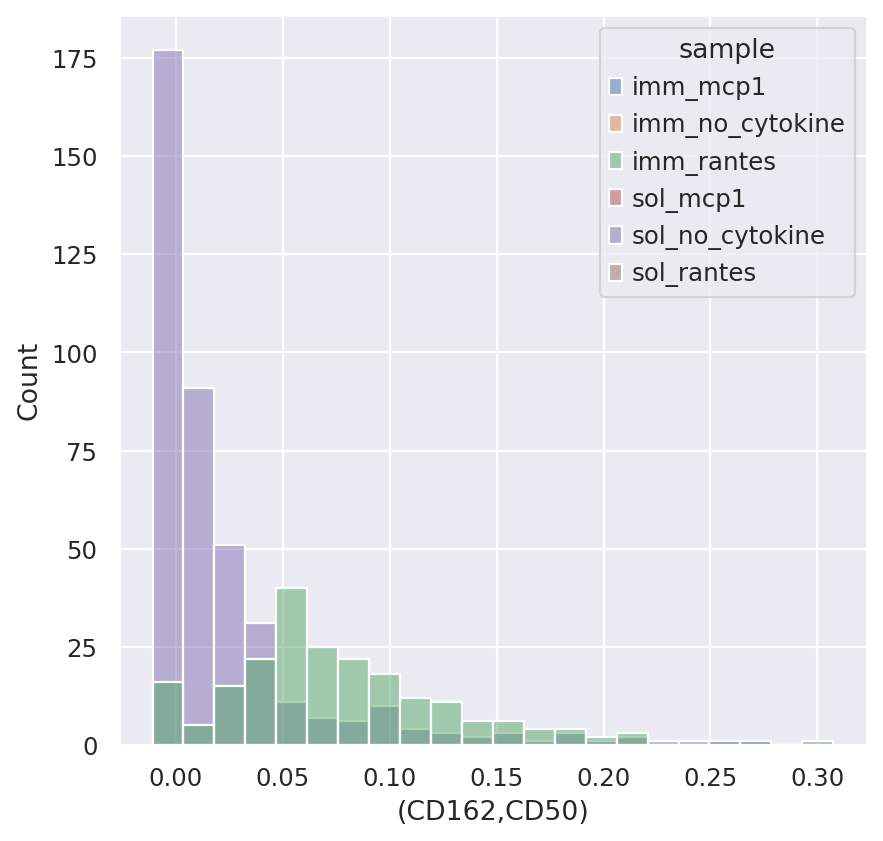

In [62]:
pol_hs_pivot = adata.uns['pol_hs_10'].pivot_table(index='component', columns='marker', values='hs_pol', fill_value=0).reindex(adata.obs.index)
coloc_hs_pivot = adata.uns['coloc_hs_10'].pivot_table(index='component', columns='pair_name', values='coloc_hs', fill_value=0).reindex(adata.obs.index)
# adata.obs['CD50_pol_hs'] = pol_hs_pivot['CD50']
# sns.histplot(adata.obs[adata.obs['sample'].isin(['sol_rantes', 'imm_rantes'])], x='CD50_pol_hs', hue='sample')
coloc_varies = (coloc_hs_pivot.std(axis=0) > 0.01)
coloc_hs_pivot = coloc_hs_pivot[coloc_varies[coloc_varies].index]

# pol_varies = (pol_hs_pivot.abs().std(axis=0) > 0.008)
# pol_hs_pivot = pol_hs_pivot[pol_varies[pol_varies].index]


adata.obs['(CD162,CD50)'] = coloc_hs_pivot['(CD162,CD50)']
sns.histplot(adata.obs[adata.obs['sample'].isin(['sol_no_cytokine', 'imm_rantes'])], x='(CD162,CD50)', hue='sample')

pol_hs_pivot.columns = [f'{col}_pol' for col in pol_hs_pivot.columns]
adata.obsm['pol_hs'] = pol_hs_pivot


adata.obsm['coloc_hs'] = coloc_hs_pivot

for key in ('pol_hs', 'coloc_hs'):
    adata.obsm[f'{key}_unit'] = (adata.obsm[key] + 1) / 2

In [ ]:
# pol_i = adata.obsm['pol_i']
# coloc_p = adata.obsm['coloc_p']

# pol_std, coloc_std = pol_i.std(axis=0), coloc_p.std(axis=0)

# hv_pol = pol_std[pol_std > 0.015].index
# hv_coloc = coloc_std.sort_values(ascending=False)[:800].index

# print(len(hv_pol))
# print(len(hv_coloc))

# adata.obsm['coloc_p_hv'] = adata.obsm['coloc_p'][hv_coloc]

# # Unit: in [0,1]
# # Scaled: scaled so the maximum std is 2
# for key in ('pol_i', 'coloc_p', 'coloc_p_hv'):
#     adata.obsm[f'{key}_unit'] = (1 + adata.obsm[key]) / 2
#     max_std = (adata.obsm[key].std(axis=0)).max()
#     adata.obsm[f'{key}_scaled'] = adata.obsm[key] * (2 / max_std)

53
800


In [45]:
# fig, ax = plt.subplots(1, 2, figsize=(8,4))
# plot_mean_std(pol_i, ax=ax[0])
# plot_mean_std(coloc_p, ax=ax[1], s=3)

# fig, ax = plt.subplots(1, 2, figsize=(8,4))
# plot_mean_std(adata.obsm['pol_i_unit'], ax=ax[0])
# plot_mean_std(adata.obsm['coloc_p_unit'], ax=ax[1], s=3)
# plot_mean_std(adata.obsm['coloc_p_hv_unit'], ax=ax[1], s=3)

In [49]:
# added_features = {'pol_i': 'CD50_pol', 'coloc_p': '(CD162,CD50)', 'coloc_p': '(CD162,CD37)'}
# for feature in added_features.values():
#     if feature in adata.obs.columns:
#         adata.obs.drop(columns=feature, inplace=True)
# pol_adata = anndata.AnnData(
#     X=adata.obsm['pol_i'],
#     obs=adata.obs,
#     layers={'unit': adata.obsm['pol_i_unit'],
#             'scaled': adata.obsm['pol_i_scaled']
#             }
# )
# coloc_adata = anndata.AnnData(
#     X=adata.obsm['coloc_p'],
#     obs=adata.obs,
#     layers={'unit': adata.obsm['coloc_p_unit'],
#             'scaled': adata.obsm['coloc_p_scaled']
#             }
# )
# coloc_hv_adata = anndata.AnnData(
#     X=adata.obsm['coloc_p_hv'],
#     obs=adata.obs,
#     layers={'unit': adata.obsm['coloc_p_hv_unit'],
#             'scaled': adata.obsm['coloc_p_hv_scaled']
#             }
# )
# # joint_adata = anndata.AnnData(
# #     X=pd.concat((adata.to_df('dsb'), adata.obsm['polarization_morans_i']), axis=1),
# #     obs=adata.obs
# # )
# for mod, feature in added_features.items():
#     adata.obs[feature] = adata.obsm[mod][feature]
#     if mod == 'pol_i':
#         coloc_adata.obs[feature] = adata.obsm[mod][feature]
#         coloc_hv_adata.obs[feature] = adata.obsm[mod][feature]
#     elif mod == 'coloc_p':
#         pol_adata.obs[feature] = adata.obsm[mod][feature]
#     else:
#         raise RuntimeError
# add_one_hot_encoding_obsm(adata, obs_column='cell_type')

Text(0.5, 0.98, 'Abundance (latent=PCA)')

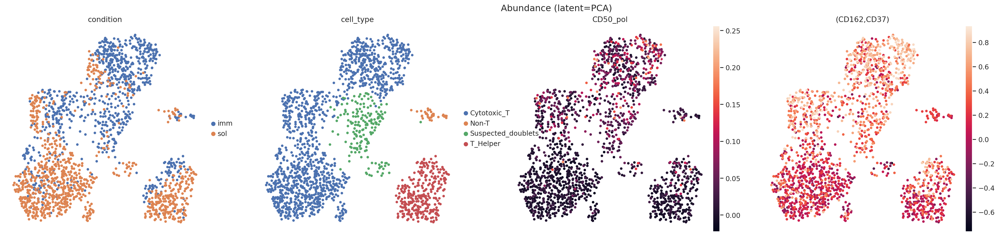

In [35]:
sc.pp.pca(adata, layer='dsb')
sc.pp.neighbors(adata, key_added='abundance_pca')
sc.tl.umap(adata, neighbors_key='abundance_pca')
sc.pl.umap(adata, layer='dsb', color=['condition', 'cell_type', 'CD50_pol', '(CD162,CD37)', ], return_fig=True).suptitle('Abundance (latent=PCA)')

### Separate abundance, polarization, and colocalization models

In [5]:
def train_model(adata, model_cls, setup_kwargs, model_kwargs, train_kwargs, modalities_latent_names):
    '''
    modalities_latent_names: list of tuples with name of modality (combined is None, main is 'X') and name of latent to put in adata
    '''
    model_cls.setup_anndata(adata, **setup_kwargs)
    model = model_cls(adata, **model_kwargs)
    model.train(**train_kwargs)
    ax = plot_losses(model)

    for modality, latent_name in modalities_latent_names:
        adata.obsm[latent_name] = model.get_latent_representation(modality=modality)
    
    return model

In [51]:
model_cls = MultiModalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=50, batch_size=2000,
                    max_epochs=10000, enable_checkpointing=True, plan_kwargs=dict(lr=3e-4, optimizer='Adam', n_epochs_kl_warmup=400))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, )
marginal_models = []
for mod_adata, layer, latent_name in zip((adata, pol_adata, coloc_hv_adata), ('dsb', 'unit', 'unit'), ('abundance_model', 'pol_i_unit_model', 'coloc_p_hv_unit_model')):
    model_kwargs['distrs'] = [{'dsb': 'normal', 'unit': 'beta'}[layer]]
    setup_kwargs = dict(layer=layer, batch_key=None)
    model = train_model(mod_adata, model_cls=model_cls, setup_kwargs=setup_kwargs, model_kwargs=model_kwargs, train_kwargs=train_kwargs, 
                        modalities_latent_names=[('X', latent_name)])
    marginal_models.append(model)
    fig = pca_neighbors_umap(mod_adata, latent_name, umap_pl_kwargs=dict(color=['condition', 'cell_type', 'CD50_pol', '(CD162,CD50)'])).suptitle(latent_name)
    fig.show()
abundance_model, pol_i_model, coloc_p_hv_model = marginal_models

NameError: name 'pol_adata' is not defined

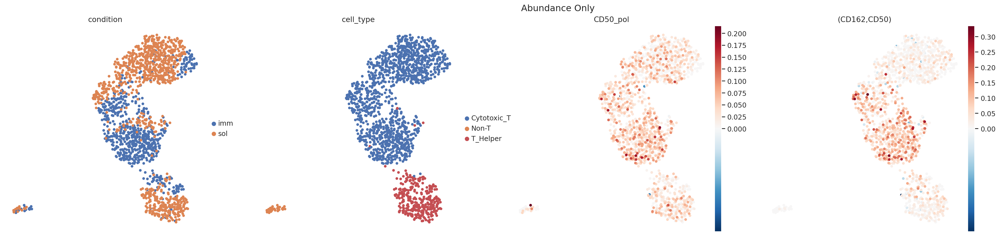

In [56]:
model_cls = MultiModalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=50, batch_size=2000,
                    max_epochs=10000, enable_checkpointing=True, plan_kwargs=dict(lr=3e-4, optimizer='Adam', n_epochs_kl_warmup=400))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, )

model_kwargs['distrs'] = ['normal']
setup_kwargs = dict(layer='dsb', batch_key=None)
latent_name = 'abundance_model'

adata.obs['CD50_pol'] = adata.obsm['pol_hs']['CD50_pol']
adata.obs['(CD162,CD50)'] = adata.obsm['coloc_hs']['(CD162,CD50)']

# abundance_model = train_model(adata, model_cls=model_cls, setup_kwargs=setup_kwargs, model_kwargs=model_kwargs, train_kwargs=train_kwargs, 
#                         modalities_latent_names=[('X', latent_name)])

fig = pca_neighbors_umap(adata, latent_name, umap_pl_kwargs=dict(color=['condition', 'cell_type', 'CD50_pol', '(CD162,CD50)'], vcenter=0, cmap='RdBu_r')).suptitle('Abundance Only')

In [38]:
autocorr = distr_autocorrelation_in_latent(coloc_hv_adata, latent_neighbors_connectivities_key_lst=['coloc_p_hv_unit_model_connectivities'], 
                                           names=['Coloc Model'], distr_key='unit')
print(autocorr.sort_values(by='morans', ascending=False)[:20].index)

Index(['(CD162,CD50)', '(CD37,CD50)', '(CD162,CD37)', '(ACTB,B2M)',
       '(ACTB,HLA-ABC)', '(CD279,CD40)', '(ACTB,CD40)', '(CD268,CD40)',
       '(ACTB,CD127)', '(CD268,CD279)', '(B2M,CD279)', '(CD127,CD40)',
       '(ACTB,CD25)', '(CD279,HLA-ABC)', '(ACTB,CD278)', '(ACTB,CD279)',
       '(CD268,CD278)', '(CD278,CD279)', '(CD279,CD53)', '(CD25,CD279)'],
      dtype='object')


## Multi Modal Model

In [ ]:
# orig_adata = adata.copy()


['T_Helper', 'Cytotoxic_T', 'Non-T']
Categories (3, object): ['Cytotoxic_T', 'Non-T', 'T_Helper']


INFO     Using column names from columns of adata.obsm['pol_i_unit']                                               
INFO     Using column names from columns of adata.obsm['coloc_p_hv_unit']                                          


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 50 records. Best score: -868.652. Signaling Trainer to stop.


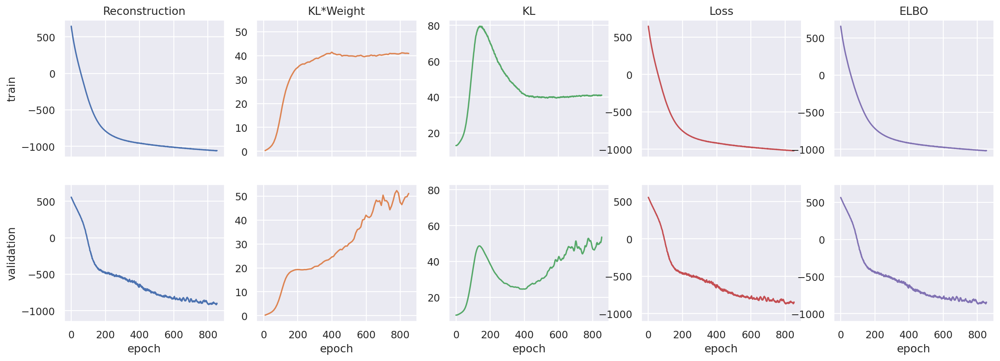

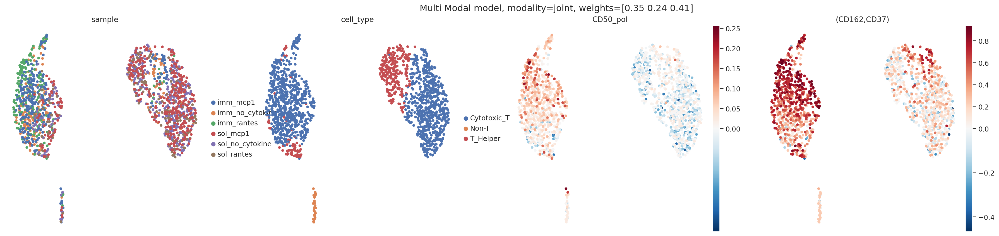

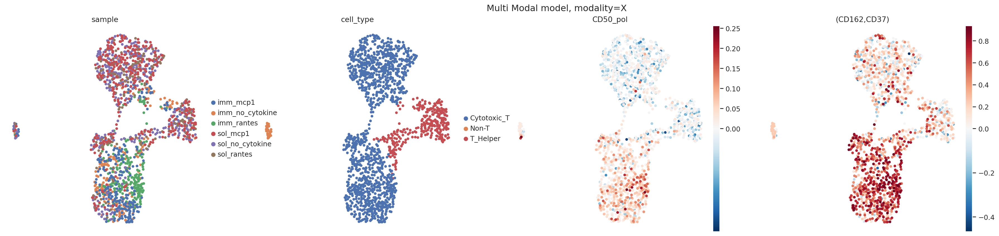

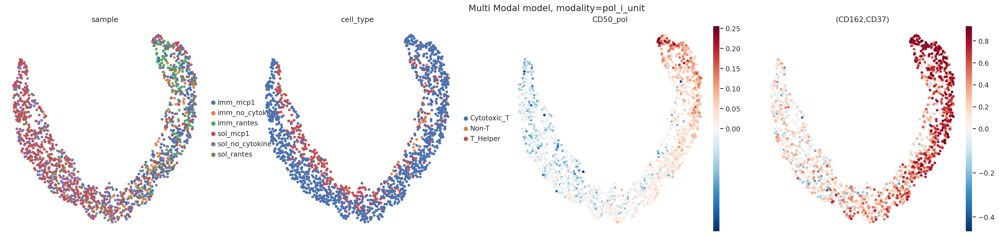

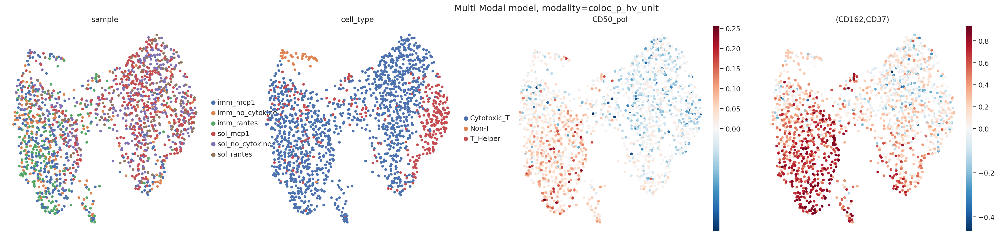

In [40]:
model_cls = MultiModalSCVI
setup_kwargs = dict(layer='dsb', batch_key=None, obsm_extra_modality_keys=['pol_i_unit', 'coloc_p_hv_unit'], n_modalities=3)
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, distrs=['normal', 'beta', 'beta'], weights=None, agg_method='learned_global_avg',
                    unimodal_kl=True, joint_kl=True, 
                    )

train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=50, batch_size=2000,
                    max_epochs=10000, enable_checkpointing=True, plan_kwargs=dict(lr=3e-4, optimizer='Adam', n_epochs_kl_warmup=400))

modalities_latent_names = [('joint', 'multi_model_joint'), ('X', 'multi_model_abundance'), ('pol_i_unit', 'multi_model_pol'), ('coloc_p_hv_unit', 'multi_model_coloc')]

multi_model = train_model(adata, model_cls=model_cls, setup_kwargs=setup_kwargs, model_kwargs=model_kwargs, train_kwargs=train_kwargs, modalities_latent_names=modalities_latent_names)

for modality, latent_name in modalities_latent_names:
    fig = pca_neighbors_umap(adata, latent_name, umap_pl_kwargs=dict(color=['sample', 'cell_type', 'CD50_pol', '(CD162,CD37)'], vcenter=0, cmap='RdBu_r'), )
    weights = multi_model.module.weights
    weights_str = np.array2string(weights, precision=2) if weights is not None else 'Per Point'
    if modality == 'joint':
        fig.suptitle(f'Multi Modal model, modality={modality}, weights={weights_str}')
    else:
        fig.suptitle(f'Multi Modal model, modality={modality}')
    fig.show()

In [41]:
rantes_components = [c for c in adata.obs.index if 'rantes' in c]
rantes_adata = adata[rantes_components, :]

In [60]:
s = pair2str('CD102', 'CD37', sort=True)
print(s in coloc_adata.var_names)
print(s in coloc_hv_adata.var_names)

True
True


In [62]:
coloc_hv_adata.to_df()[s]

component
RCVCMP0000001_imm_no_cytokine   -0.053976
RCVCMP0000004_imm_no_cytokine    0.108022
RCVCMP0000006_imm_no_cytokine    0.473958
RCVCMP0000008_imm_no_cytokine    0.789185
RCVCMP0000018_imm_no_cytokine    0.004393
                                   ...   
RCVCMP0000786_sol_mcp1          -0.065037
RCVCMP0000812_sol_mcp1           0.210768
RCVCMP0000857_sol_mcp1           0.160433
RCVCMP0000868_sol_mcp1          -0.333267
RCVCMP0000945_sol_mcp1          -0.060055
Name: (CD102,CD37), Length: 1817, dtype: float64

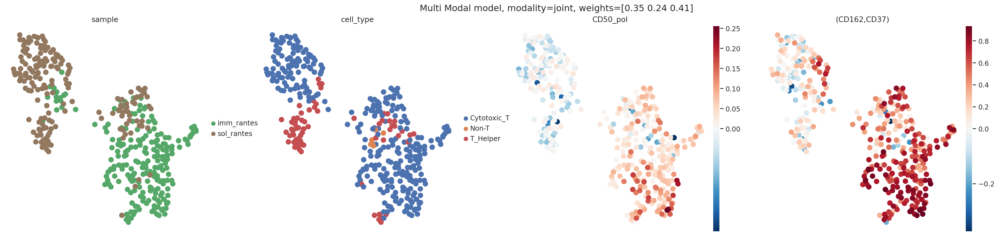

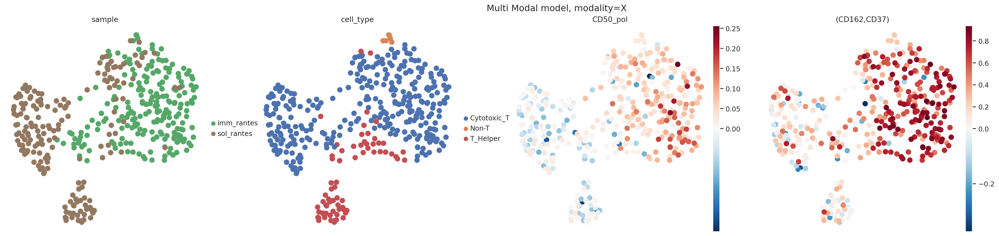

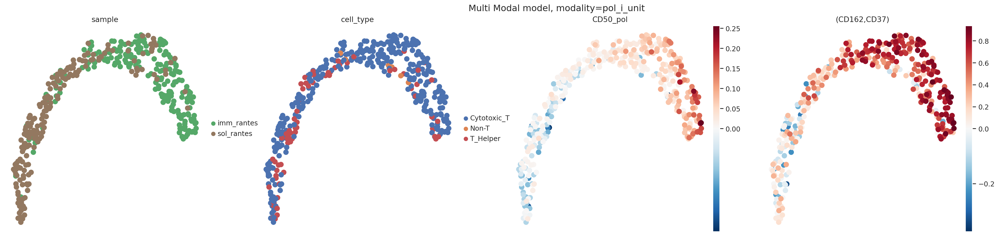

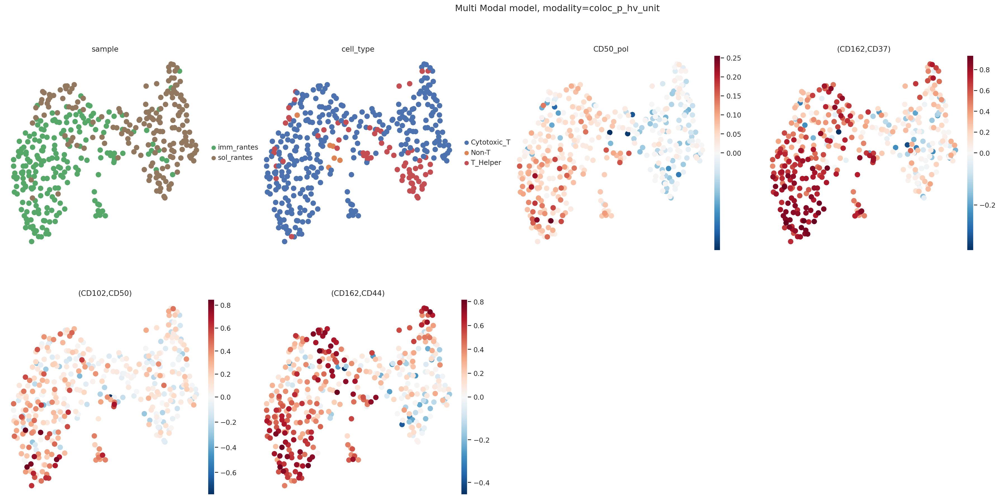

In [69]:
for modality, latent_name in modalities_latent_names:
    color = ['sample', 'cell_type', 'CD50_pol', '(CD162,CD37)']
    if 'coloc' in latent_name:
        pairs = [pair2str('CD102', 'CD50', sort=True), pair2str('CD162', 'CD44', sort=True)]
        color += pairs
        for pair in pairs:
            rantes_adata.obs[pair] = adata.obsm['coloc_p'][pair]
    fig = pca_neighbors_umap(rantes_adata, latent_name, umap_pl_kwargs=dict(color=color, vcenter=0, cmap='RdBu_r'), )
    weights = multi_model.module.weights
    weights_str = np.array2string(weights, precision=2) if weights is not None else 'Per Point'
    if modality == 'joint':
        fig.suptitle(f'Multi Modal model, modality={modality}, weights={weights_str}')
    else:
        fig.suptitle(f'Multi Modal model, modality={modality}')
    fig.show()

In [77]:
adata.obs[adata.obs['sample'] == 'sol_no_cytokine'].index

Index(['RCVCMP0000000_sol_no_cytokine', 'RCVCMP0000001_sol_no_cytokine',
       'RCVCMP0000002_sol_no_cytokine', 'RCVCMP0000004_sol_no_cytokine',
       'RCVCMP0000006_sol_no_cytokine', 'RCVCMP0000008_sol_no_cytokine',
       'RCVCMP0000009_sol_no_cytokine', 'RCVCMP0000010_sol_no_cytokine',
       'RCVCMP0000011_sol_no_cytokine', 'RCVCMP0000012_sol_no_cytokine',
       ...
       'RCVCMP0000900_sol_no_cytokine', 'RCVCMP0000916_sol_no_cytokine',
       'RCVCMP0000921_sol_no_cytokine', 'RCVCMP0000975_sol_no_cytokine',
       'RCVCMP0000979_sol_no_cytokine', 'RCVCMP0000983_sol_no_cytokine',
       'RCVCMP0001004_sol_no_cytokine', 'RCVCMP0001014_sol_no_cytokine',
       'RCVCMP0001030_sol_no_cytokine', 'RCVCMP0001046_sol_no_cytokine'],
      dtype='object', name='component', length=407)

In [78]:
adata.obsm['coloc_p'].loc['RCVCMP0000000_sol_no_cytokine', '(CD162,CD37)']

0.034199534614229844

In [43]:
adata.obsm['coloc_p']['(CD162,CD37)'].sort_values(ascending=False)

component
RCVCMP0001352_imm_rantes         0.938389
RCVCMP0001141_imm_rantes         0.934702
RCVCMP0005012_imm_rantes         0.932301
RCVCMP0000741_imm_no_cytokine    0.926398
RCVCMP0001292_imm_rantes         0.924877
                                   ...   
RCVCMP0000487_sol_no_cytokine   -0.372761
RCVCMP0000042_imm_rantes        -0.374877
RCVCMP0000150_sol_mcp1          -0.395741
RCVCMP0000415_sol_mcp1          -0.447157
RCVCMP0000299_sol_no_cytokine   -0.466850
Name: (CD162,CD37), Length: 1640, dtype: float64

In [46]:
# pg_data.edgelist.head(10)

In [53]:
def plot_corr_data(counts, norm_counts, corr, norm_corr, m1, m2):
    fig, ax = plt.subplots(1,2,figsize=(12,7))
    df_agg = counts.groupby([m1,m2]).size().reset_index(name='count')
    df_agg['log_count'] = np.log(df_agg['count'])

    df_norm_agg = norm_counts.groupby([m1,m2]).size().reset_index(name='count')
    df_norm_agg['log_count'] = np.log(df_agg['count'])
    # df_agg = df_agg[df_agg[m1] + df_agg[m2] > 0]


    # Create a scatter plot where 'count' determines the marker size.
    sns.scatterplot(data=df_agg, x=m1, y=m2, size='log_count', sizes=(20, 200), legend=True, ax=ax[0])
    # sns.scatterplot(gld_a_counts,x='CD162',y='CD50', ax=ax[0])
    sns.scatterplot(data=df_norm_agg,x=m1,y=m2, size='log_count', sizes=(20, 200), legend=True, ax=ax[1])
    ax[0].set_title(f'{corr.loc[m1,m2]:.3f}')
    ax[1].set_title(f'{norm_corr.loc[m1,m2]:.3f}')

    for i, df in enumerate((counts, norm_counts)):
        ax[i].axhline(y=df[m2].mean(), linestyle='--')
        ax[i].axvline(x=df[m1].mean(), linestyle='--')

In [6]:
from scipy.sparse import coo_array
from graph_coarsening.graph_coarsening.coarsening_utils import coarsen

16097


<Axes: xlabel='Count', ylabel='Count'>

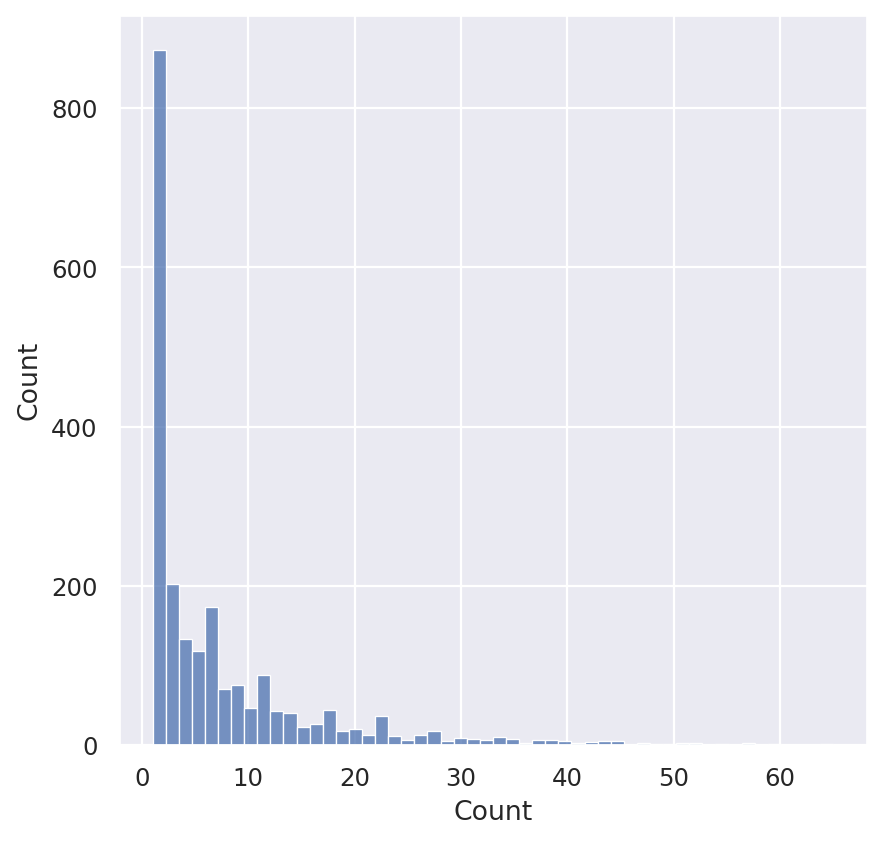

In [98]:
pixel_counts = results['pixel_counts']
a_pixel_counts = pixel_counts[pixel_counts['type'] == 'a']
pixel_size = a_pixel_counts.groupby('upi_int')['Count'].sum()
print(pixel_size.sum())
sns.histplot(pixel_size)

In [45]:
from pygsp.graphs import Graph


[03/04/25 11:26:59]: Starting conversion...


100%|██████████| 1/1 [00:00<00:00,  4.51it/s]


0.8000875848478213
0.19443836216334573


129    1
248    4
233    4
249    5
181    5
273    6
203    7
67     7
253    8
162    8
256    8
255    8
148    8
187    9
151    9
259    9
242    9
232    9
189    9
188    9
dtype: int64

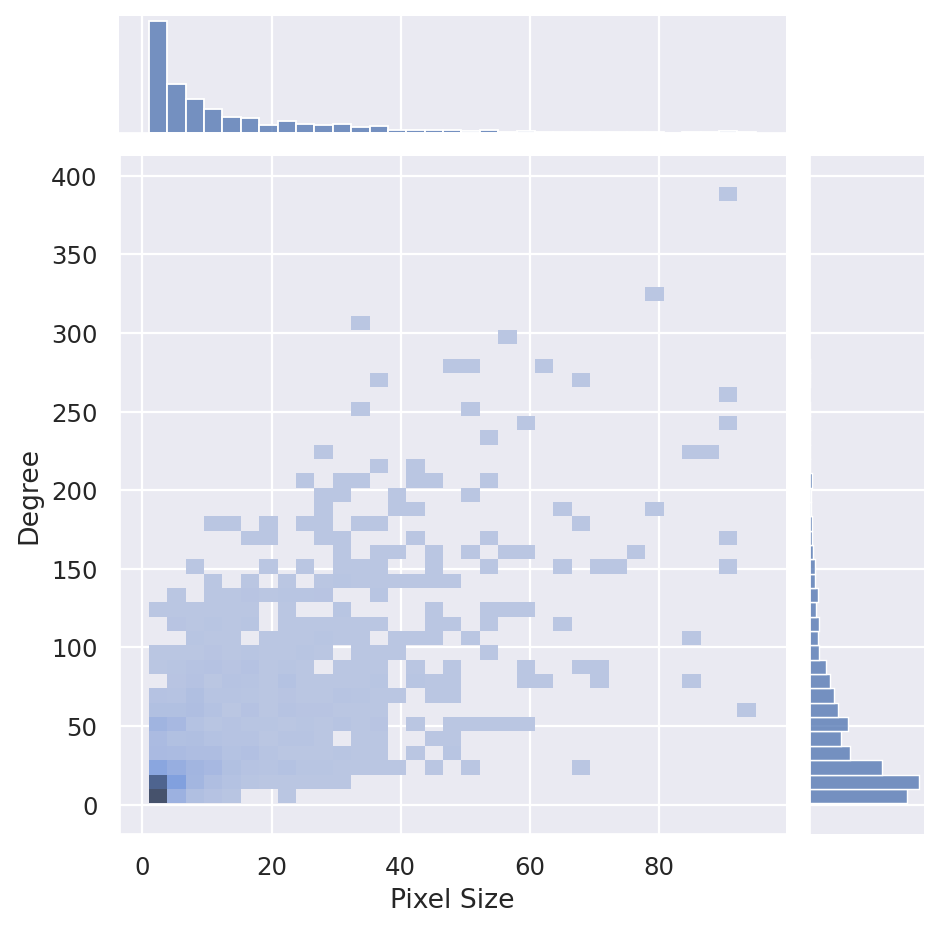

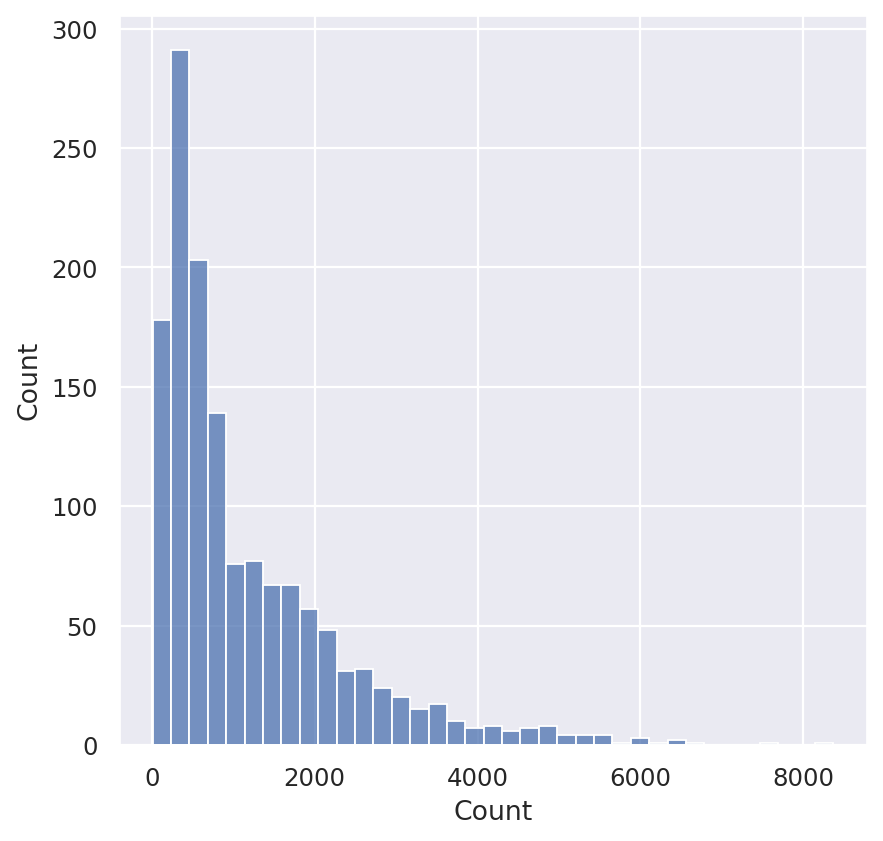

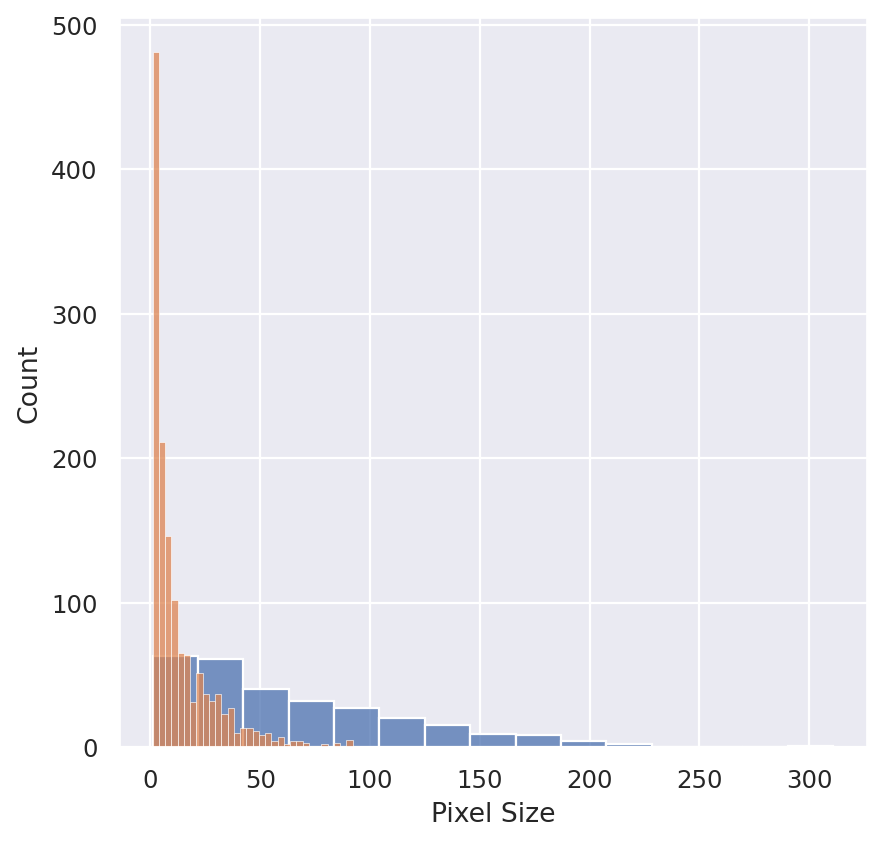

In [ ]:

# Highly affected component
component = 'RCVCMP0001352_imm_rantes'

# Control component
# component = 'RCVCMP0000000_sol_no_cytokine'

results = get_pixel_nbhd_counts(pg_data.edgelist, adata, pixel_type='a', nbhd_radius=2, components=[component], compute_pixel_graph=True)
pixel_counts = results['pixel_counts']
pixel_counts_pivot = pd.pivot_table(pixel_counts, index='upi_int', columns='marker', values='Count', observed=True, fill_value=0).astype(int)
g = results['graphs'][0]

nbhd_counts = results['nbhd_counts']
nbhd_size = nbhd_counts.groupby('nbhd_center_upi_int')['Count'].sum()
a_pixel_counts = pixel_counts[pixel_counts['type'] == 'a']
pixel_size = a_pixel_counts.groupby('upi_int')['Count'].sum().rename('Pixel Size')
# sns.histplot(pixel_size)


# sns.histplot(g.dw)
sns.jointplot(x=pixel_size, y=pd.Series(g.dw, name='Degree'), kind='hist')
fig, ax = plt.subplots()
sns.histplot(nbhd_size, ax=ax)

weights_coo = g.W.tocoo()
coords = weights_coo.row, weights_coo.col
edge_pixel_sizes = [pixel_size[i] + pixel_size[j] for i,j in zip(*coords)] 
max_edge_size = np.max(edge_pixel_sizes)
new_weights =([max_edge_size + 1 - edge_size for edge_size in edge_pixel_sizes])
new_W = coo_array((new_weights, coords), shape=weights_coo.shape)
# sns.histplot(new_weights)
new_g = Graph(new_W)
C, coarse_g, _, _ = coarsen(new_g, K=10, r=0.8, method='heavy_edge')
# _, _, weights = g.get_edge_list()
# weight_coo = g.W
# g.set_coordinates(kind='random2D')

# C.data

new_N = C.shape[0]
new_sizes = (C.astype(bool).toarray() * np.array(pixel_size).reshape((1, -1)).repeat(new_N, axis=0)).sum(axis=1)
fig, ax = plt.subplots()
sns.histplot(new_sizes, ax=ax)
sns.histplot(pixel_size, ax=ax)
print(pixel_size[pixel_size < 50].sum() / pixel_size.sum())
print(new_sizes[new_sizes < 50].sum() / new_sizes.sum())
pd.Series(new_sizes).sort_values().head(20)

In [57]:
import statsmodels.api as sm
from statsmodels.stats.weightstats import DescrStatsW

-0.5775042431850054


<Axes: xlabel='(CD44,HLA-ABC)', ylabel='Count'>

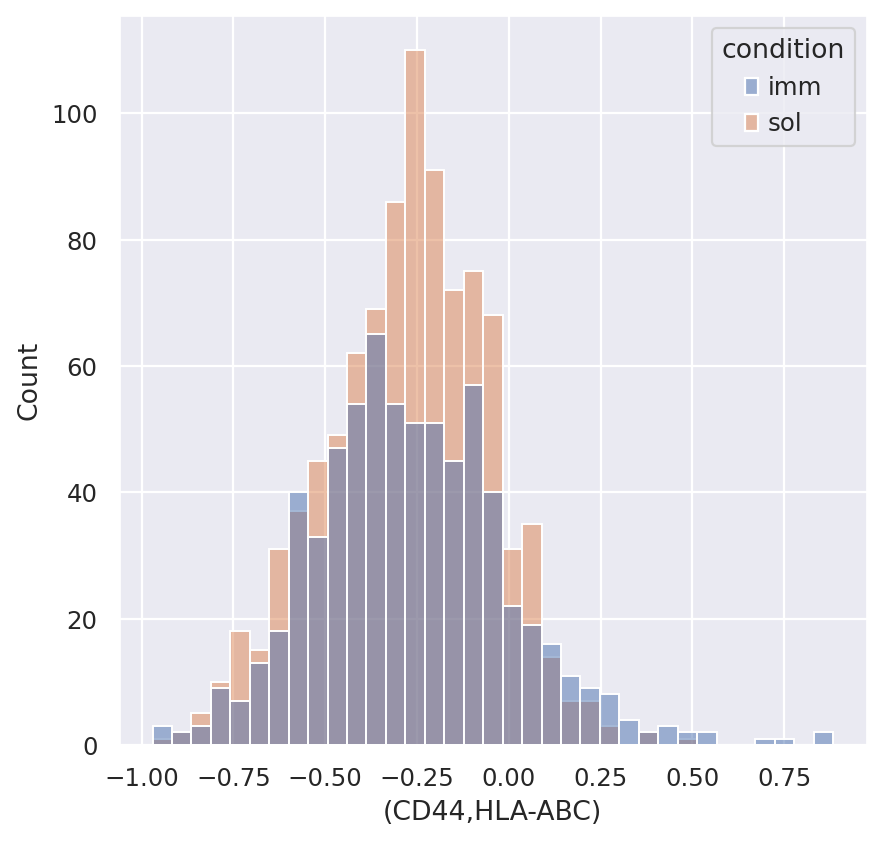

In [93]:
s = pair2str('HLA-ABC', 'CD44', sort=True)
adata.obs[s] = adata.obsm['coloc_p'][s]
print(adata.obsm['coloc_p'].loc['RCVCMP0000000_sol_no_cytokine', s])
sns.histplot(adata.obs, x=s, hue='condition')

In [ ]:

coarse_to_fine = pd.DataFrame(np.argwhere(C), columns=['coarse', 'fine'])
coarse_to_fine = coarse_to_fine.join(pixel_counts.set_index('upi_int')[['marker', 'Count']], on='fine')
coarse_counts = coarse_to_fine.groupby(['coarse', 'marker'], observed=True, as_index=False)['Count'].sum()
coarse_counts_pivot = pd.pivot_table(coarse_counts, index='coarse', columns='marker', values='Count', observed=True, fill_value=0).astype(int)
coarse_sizes = coarse_counts_pivot.sum(axis=1)

filtered_coarse = coarse_counts_pivot.loc[coarse_sizes > 50]
filtered_coarse_sizes = filtered_coarse.sum(axis=1)
filtered_coarse_norm = filtered_coarse.div(filtered_coarse_sizes, axis=0)

abundant_markers = [v for v in adata.var_names if adata.to_df('counts').loc[component, v] > 30]
# abundant_markers = [v for v in filtered_coarse.columns]

filtered_abundant = filtered_coarse[abundant_markers]
filtered_abundant_norm = filtered_coarse_norm[abundant_markers]



filtered_coarse_corr = filtered_abundant.corr('pearson')
filtered_coarse_norm_corr = filtered_abundant_norm.corr('pearson')

# plot_corr_data(counts=filtered_abundant, norm_counts=filtered_abundant_norm, corr=filtered_coarse_corr, norm_corr=filtered_coarse_norm_corr,
#                m1='CD4', m2='CD64')

long_coloc = filtered_coarse_norm_corr.melt(ignore_index=False).rename(index={'marker':'marker_1'}, columns={'marker': 'marker_2'}).reset_index()
long_coloc = long_coloc[long_coloc['value'] != 1]
long_coloc['abs'] = np.abs(long_coloc['value'])
long_coloc.sort_values(by='abs', ascending=False).head(20)
# sns.histplot(filtered_coarse_norm['CD150'])

,marker,marker_2,value,abs
96,CD37,CD162,0.673251,0.673251
264,CD162,CD37,0.673251,0.673251
794,CD3E,HLA-ABC,-0.461590,0.461590
346,HLA-ABC,CD3E,-0.461590,0.461590
375,HLA-ABC,CD44,-0.459054,0.459054
795,CD44,HLA-ABC,-0.459054,0.459054
563,CD44,CD50,0.442319,0.442319
367,CD50,CD44,0.442319,0.442319
351,CD162,CD44,0.437427,0.437427
99,CD44,CD162,0.437427,0.437427


In [159]:
coarse_distances = dijkstra(coarse_g.A, directed=False, unweighted=True)
orig_distances = dijkstra(g.A, directed=False, unweighted=True)
print(np.max(coarse_distances))
print(np.max(orig_distances))

4.0
5.0


In [7]:
def compute_hotspot_pol_and_coloc(component, vars=None, marker_count_threshold=10, knn_neighbors=30):
    # For graph computation pass all vars, to not disconnect the graph
    results = get_pixel_nbhd_counts(pg_data.edgelist, adata, pixel_type='a', nbhd_radius=2, 
                                    components=[component], compute_pixel_graph=True, verbose=False, vars=None)
    pixel_counts = results['pixel_counts']
    pixel_counts_pivot = pd.pivot_table(pixel_counts, index='upi_int', columns='marker', values='Count', observed=True, fill_value=0).astype(int)
    g = results['graphs'][0]
    distances = dijkstra(g.A, directed=False, unweighted=True)

    # counts_abundant = pixel_counts_pivot[abundant_markers]
    # sizes_abundant = counts_abundant.sum(axis=1)
    # nonempty = sizes_abundant[sizes_abundant != 0].index
    # counts_abundant = counts_abundant.loc[nonempty]
    # distances_abundant = distances[np.ix_(nonempty, nonempty)]

    # pixel_adata = anndata.AnnData(counts_abundant)
    # pixel_adata.obsp['dijkstra'] = distances_abundant
    # pixel_adata.obs['total_counts'] = pixel_adata.to_df().sum(axis=1)

    pixel_adata = anndata.AnnData(pixel_counts_pivot)
    pixel_adata.obsp['dijkstra'] = distances
    pixel_adata.obs['total_counts'] = pixel_adata.to_df().sum(axis=1)

    hs = hotspot.Hotspot(
        pixel_adata,
        layer_key=None,
        model='bernoulli',
        distances_obsp_key='dijkstra',
        umi_counts_obs_key='total_counts'
    )
    hs.create_knn_graph(weighted_graph=False, n_neighbors=knn_neighbors)
    
    hs_pol = hs.compute_autocorrelations()
    hs_pol = hs_pol.reset_index().rename(columns={'Gene': 'marker', 'C': 'hs_pol'})

    abundant_markers = [v for v in vars if adata.to_df('counts').loc[component, v] > marker_count_threshold]
    hs_pol = hs_pol[hs_pol['marker'].isin(abundant_markers)]

    local_correlations = hs.compute_local_correlations(abundant_markers)

    long_coloc = hs.local_correlation_c.reset_index().melt(id_vars='marker', var_name='marker_2', value_name='coloc_hs').rename(columns={'marker': 'marker_1'})
    long_coloc = long_coloc[long_coloc['marker_1'] != long_coloc['marker_2']]
    long_coloc['pair_name'] = [pair2str(m1, m2, sort=True) for m1, m2 in zip(long_coloc['marker_1'], long_coloc['marker_2'])]
    long_coloc = long_coloc.drop_duplicates(subset='pair_name')

    return hs_pol, long_coloc

In [335]:
# component = 'RCVCMP0001352_imm_rantes'
component = 'RCVCMP0000000_sol_no_cytokine'
component = 'RCVCMP0000001_sol_no_cytokine'
component = 'RCVCMP0000002_sol_no_cytokine'
comp_pol, comp_coloc = compute_hotspot_pol_and_coloc(component, marker_count_threshold=10, vars=non_isotype_vars)
# comp_coloc[comp_coloc['marker_1'] == 'CD50'].sort_values(by='coloc_hs', ascending=False)

ValueError: too many values to unpack (expected 2)

In [295]:
np.log1p(20)

3.044522437723423

In [15]:
from IPython.utils import io

all_pol = []
all_coloc = []
for component in tqdm(adata.obs.index):
    try:
        with io.capture_output() as captured:
            comp_pol, comp_coloc = compute_hotspot_pol_and_coloc(component, marker_count_threshold=10, vars=non_isotype_vars)
    except ValueError:
        print(component)
        break
    comp_pol['component'] = component
    comp_coloc['component'] = component
    all_pol.append(comp_pol)
    all_coloc.append(comp_coloc)
pol = pd.concat(all_pol, axis=0, ignore_index=True)
coloc = pd.concat(all_coloc, axis=0, ignore_index=True)

adata.uns['pol_hs_10'] = pol
adata.uns['coloc_hs_10'] = coloc
adata.write_h5ad(DATASET_DIR / 'uropod_hs_10.h5ad')

100%|██████████| 1640/1640 [28:39<00:00,  1.05s/it] 


In [351]:
abundant_markers = [v for v in vars if adata.to_df('counts').loc[component, v] > 10]
pol['marker'].isin(abundant_markers)
# pol = pol[pol['marker'].isin(abundant_markers)]

0     True
1     True
2     True
14    True
16    True
17    True
21    True
32    True
36    True
38    True
42    True
43    True
44    True
46    True
47    True
48    True
49    True
50    True
51    True
52    True
53    True
54    True
55    True
56    True
57    True
58    True
59    True
60    True
61    True
62    True
63    True
64    True
65    True
66    True
67    True
68    True
69    True
70    True
71    True
72    True
73    True
74    True
Name: marker, dtype: bool

In [359]:
component = 'RCVCMP0000006_imm_no_cytokine'
pol, coloc = compute_hotspot_pol_and_coloc(component, marker_count_threshold=10, vars=non_isotype_vars) 
coloc['marker_2']

/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
100%|██████████| 75/75 [00:00<00:00, 867.60it/s]


Computing pair-wise local correlation on 42 features...


100%|██████████| 861/861 [00:00<00:00, 12797.48it/s]


1           B2M
2           B2M
3           B2M
4           B2M
5           B2M
         ...   
1636       CD86
1637       CD86
1678    HLA-ABC
1679    HLA-ABC
1721     HLA-DR
Name: marker_2, Length: 861, dtype: object

In [232]:
coloc_varies = (coloc_hs_pivot.abs().max(axis=0) > 0.05)
coloc_varies[coloc_varies].index

Index(['(ACTB,B2M)', '(ACTB,CD11a)', '(ACTB,CD11c)', '(ACTB,CD127)',
       '(ACTB,CD14)', '(ACTB,CD150)', '(ACTB,CD154)', '(ACTB,CD16)',
       '(ACTB,CD161)', '(ACTB,CD162)',
       ...
       '(HLA-ABC,HLA-DR)', '(HLA-ABC,TCRVb5)', '(HLA-ABC,mIgG1)',
       '(HLA-ABC,mIgG2a)', '(HLA-ABC,mIgG2b)', '(HLA-DR,TCRVb5)',
       '(HLA-DR,mIgG2a)', '(TCRVb5,mIgG1)', '(TCRVb5,mIgG2b)',
       '(mIgG1,mIgG2b)'],
      dtype='object', name='pair_name', length=1665)

In [326]:
adata.uns['pol_hs_10'].pivot_table(index='component', columns='marker', values='hs_pol', fill_value=0)

/tmp/ipykernel_1870173/3266805447.py:1: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  adata.uns['pol_hs_10'].pivot_table(index='component', columns='marker', values='hs_pol', fill_value=0)


marker,ACTB,B2M,CD102,CD11a,CD11b,CD11c,CD127,CD137,CD14,CD150,...,CD71,CD72,CD8,CD82,CD84,CD86,CD9,HLA-ABC,HLA-DR,TCRVb5
component,,,,,,,,,,,,,,,,,,,,,
RCVCMP0000000_sol_no_cytokine,0.0,0.000949,-0.012483,-0.004407,0.0,0.0,0.011068,0.0,0.0,0.0,...,0.000000,0.0,-0.000782,0.000896,0.023049,0.000000,0.0,0.013826,-0.000408,0.000000
RCVCMP0000000_sol_rantes,0.0,-0.006332,0.013120,0.005312,0.0,0.0,0.006801,0.0,0.0,0.0,...,0.000000,0.0,-0.004793,0.007865,0.000000,0.018181,0.0,-0.000562,0.013945,0.000000
RCVCMP0000001_sol_mcp1,0.0,0.001321,0.011874,-0.010923,0.0,0.0,0.009012,0.0,0.0,0.0,...,0.000000,0.0,0.041074,0.017348,0.030045,0.046603,0.0,0.001694,0.016166,0.000000
RCVCMP0000001_sol_no_cytokine,0.0,-0.007241,0.006815,-0.011428,0.0,0.0,0.023227,0.0,0.0,0.0,...,0.000000,0.0,0.005181,0.018909,0.000000,0.028069,0.0,-0.003179,-0.000392,0.027332
RCVCMP0000002_imm_mcp1,0.0,-0.002887,0.027086,0.009291,0.0,0.0,0.043280,0.0,0.0,0.0,...,0.000000,0.0,0.000813,0.032040,0.000000,-0.008686,0.0,0.002311,0.010719,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
RCVCMP0003509_imm_rantes,0.0,-0.014025,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,...,0.000000,0.0,0.000000,0.022773,0.000000,0.000000,0.0,-0.001058,0.014037,0.000000
RCVCMP0003600_imm_no_cytokine,0.0,-0.002042,0.014338,0.000850,0.0,0.0,0.027468,0.0,0.0,0.0,...,0.000000,0.0,0.047769,0.028497,0.007303,0.022441,0.0,-0.012505,0.000373,0.000000
RCVCMP0004117_imm_rantes,0.0,0.050763,0.000000,0.030727,0.0,0.0,0.000000,0.0,0.0,0.0,...,0.008023,0.0,0.035163,0.050699,0.000000,0.000529,0.0,0.062316,0.228220,0.000000


/tmp/ipykernel_2067763/786302893.py:1: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pol_hs_pivot = adata.uns['pol_hs_10'].pivot_table(index='component', columns='marker', values='hs_pol', fill_value=0).reindex(adata.obs.index)


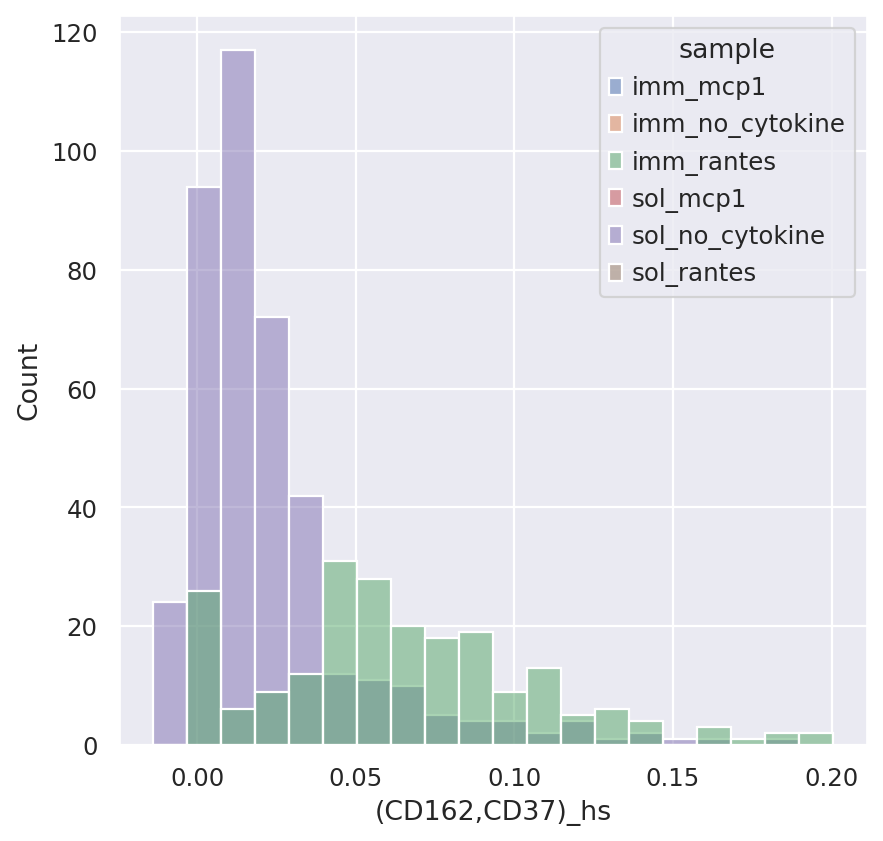

In [16]:
pol_hs_pivot = adata.uns['pol_hs_10'].pivot_table(index='component', columns='marker', values='hs_pol', fill_value=0).reindex(adata.obs.index)
coloc_hs_pivot = adata.uns['coloc_hs_10'].pivot_table(index='component', columns='pair_name', values='coloc_hs', fill_value=0).reindex(adata.obs.index)
# adata.obs['CD50_pol_hs'] = pol_hs_pivot['CD50']
# sns.histplot(adata.obs[adata.obs['sample'].isin(['sol_rantes', 'imm_rantes'])], x='CD50_pol_hs', hue='sample')
coloc_varies = (coloc_hs_pivot.std(axis=0) > 0.005)
coloc_hs_pivot = coloc_hs_pivot[coloc_varies[coloc_varies].index]

# pol_varies = (pol_hs_pivot.abs().std(axis=0) > 0.008)
# pol_hs_pivot = pol_hs_pivot[pol_varies[pol_varies].index]


adata.obs['(CD162,CD37)_hs'] = coloc_hs_pivot['(CD162,CD37)']
sns.histplot(adata.obs[adata.obs['sample'].isin(['sol_no_cytokine', 'imm_rantes'])], x='(CD162,CD37)_hs', hue='sample')

pol_hs_pivot.columns = [f'{col}_pol' for col in pol_hs_pivot.columns]
adata.obsm['pol_hs'] = pol_hs_pivot


adata.obsm['coloc_hs'] = coloc_hs_pivot

for key in ('pol_hs', 'coloc_hs'):
    adata.obsm[f'{key}_unit'] = (adata.obsm[key] + 1) / 2

# sns.histplot(adata.obsm['coloc_hs_unit']['(CD162,CD37)'])

INFO     Using column names from columns of adata.obsm['pol_hs_unit']                                              
INFO     Using column names from columns of adata.obsm['coloc_hs_unit']                                            


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 30 records. Best score: -5142.890. Signaling Trainer to stop.


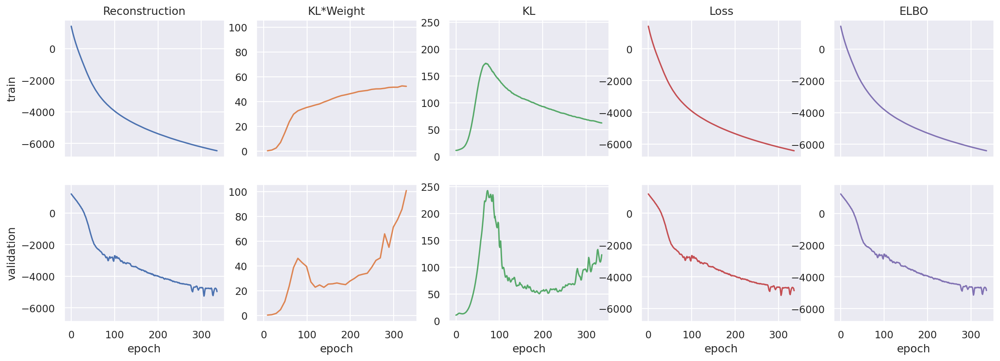

In [60]:
model_cls = MultiModalSCVI
setup_kwargs = dict(layer='dsb', batch_key=None, obsm_extra_modality_keys=['pol_hs_unit', 'coloc_hs_unit'], n_modalities=3)
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, distrs=['normal', 'beta', 'beta'], weights=None, agg_method='learned_global_avg',
                    unimodal_kl=True, joint_kl=True, 
                    )

train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=30, batch_size=2000,
                    max_epochs=10000, enable_checkpointing=True, plan_kwargs=dict(lr=1e-3, optimizer='Adam', n_epochs_kl_warmup=400))

modalities_latent_names = [('joint', 'multi_hs_model_joint'), ('X', 'multi_hs_model_abundance'), ('pol_hs_unit', 'multi_hs_model_pol'), ('coloc_hs_unit', 'multi_hs_model_coloc')]

multi_model = train_model(adata, model_cls=model_cls, setup_kwargs=setup_kwargs, model_kwargs=model_kwargs, train_kwargs=train_kwargs, modalities_latent_names=modalities_latent_names)

In [ ]:
sc.pl.umap

/home/projects/nyosef/eitangr/pixelgen/PixelGen/pxl_utils.py:822: ImplicitModificationWarning: Setting element `.obsm['multi_hs_model_joint_pca']` of view, initializing view as actual.
  adata.obsm[f'{key_added}_pca'] = pca_data.obsm['X_pca']


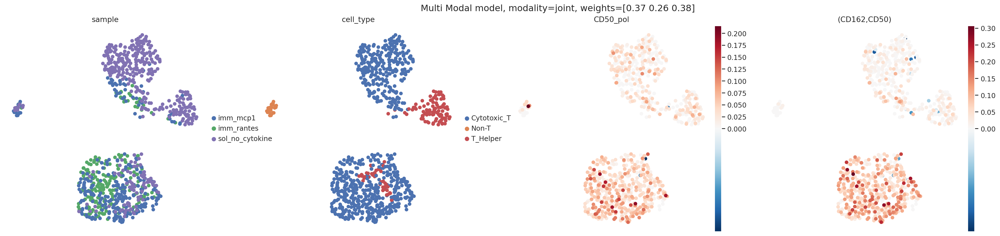

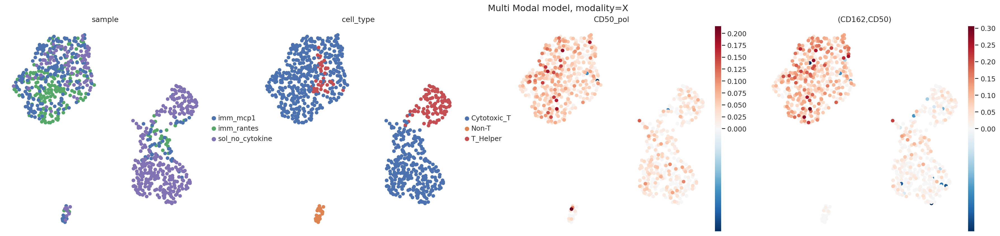

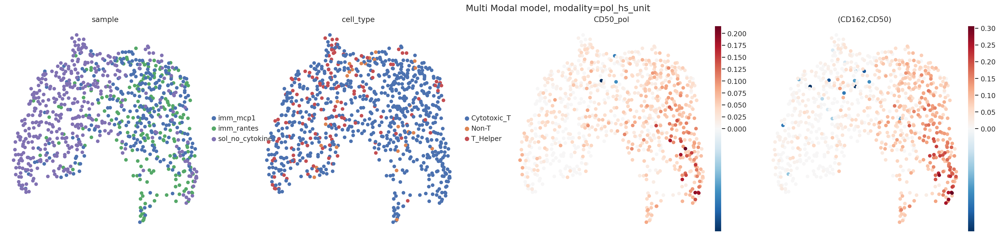

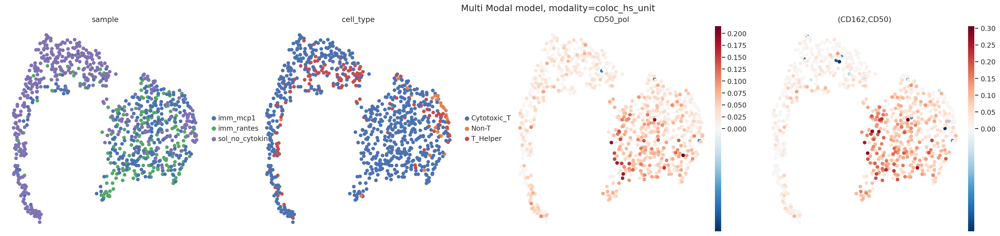

In [61]:
adata.obs['CD50_pol'] = adata.obsm['pol_hs']['CD50_pol']
adata.obs['(CD162,CD50)'] = adata.obsm['coloc_hs']['(CD162,CD50)']
adata.obs['(CD18,CD50)'] = adata.obsm['coloc_hs']['(CD18,CD50)']
adata.obs['(CD44,CD50)'] = adata.obsm['coloc_hs']['(CD44,CD50)']

adata.obs['Abundant CD50'] = adata.to_df('counts')['CD50'] > 10

plot_obs = adata.obs[adata.obs['sample'].isin(['imm_rantes', 'imm_mcp1', 'sol_no_cytokine'])].index
plot_adata = adata[plot_obs, :]


# umap_colors = ['sample', 'condition', 'cell_type', '(CD162,CD50)', 'CD44', 'Abundant CD50', 'CD18', '(CD44,CD50)']
umap_colors = ['sample', 'cell_type', 'CD50_pol', '(CD162,CD50)', ]

for modality, latent_name in modalities_latent_names:
    fig = pca_neighbors_umap(plot_adata, latent_name, umap_pl_kwargs=dict(color=umap_colors, vcenter=0, cmap='RdBu_r', layer='log1p'), )
    weights = multi_model.module.weights
    weights_str = np.array2string(weights, precision=2) if weights is not None else 'Per Point'
    if modality == 'joint':
        fig.suptitle(f'Multi Modal model, modality={modality}, weights={weights_str}')
    else:
        fig.suptitle(f'Multi Modal model, modality={modality}')
    fig.show()

In [30]:
plot_adata.obsm

AxisArrays with keys: X_pca, X_umap, coloc_p, coloc_z, pol_i, pol_z, pol_hs, coloc_hs, pol_hs_unit, coloc_hs_unit, multi_hs_model_joint, multi_hs_model_abundance, multi_hs_model_pol, multi_hs_model_coloc, multi_hs_model_joint_pca, multi_hs_model_abundance_pca, multi_hs_model_pol_pca, multi_hs_model_coloc_pca

In [29]:
umap_colors = ['sample', 'cell_type', 'CD50_pol', '(CD162,CD50)', ]
fig = pca_neighbors_umap(plot_adata, 'abundance_model', umap_pl_kwargs=dict(color=umap_colors, vcenter=0, cmap='RdBu_r', layer='log1p')).suptitle('Abundance Only')

RuntimeError: rep is not in layers or obsm

<Axes: xlabel='(CD44,CD50)', ylabel='Count'>

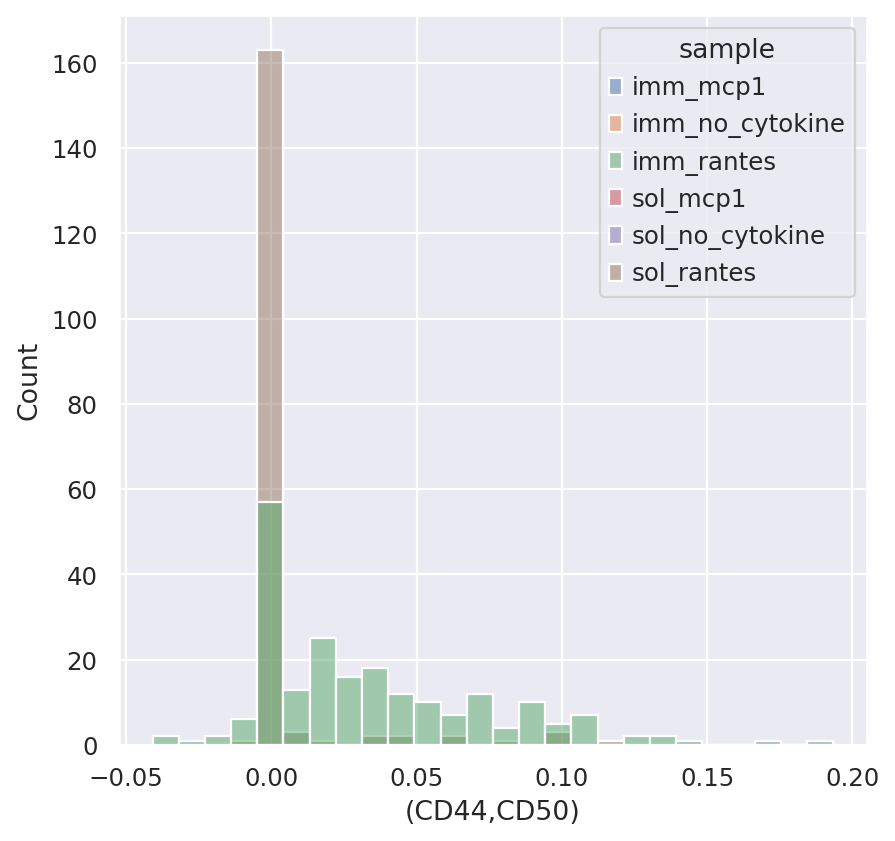

In [275]:
coloc_hs_adata = anndata.AnnData(adata.obsm['coloc_hs'])
pol_hs_adata = anndata.AnnData(adata.obsm['pol_hs'])

coloc_hs_adata.obs['sample'] = pol_hs_adata.obs['sample'] = adata.obs['sample']

s = pair2str('CD44', 'CD50', sort=True)
adata.obs[s] = adata.obsm['coloc_hs'][s]
samples = ['imm_rantes', 'sol_rantes']

sns.histplot(adata.obs[adata.obs['sample'].isin(samples)], x=s, hue='sample')

In [254]:
coloc_autocorr = distr_autocorrelation_in_latent(adata, 
                latent_neighbors_connectivities_key_lst=['multi_hs_model_coloc_connectivities', 'multi_hs_model_joint_connectivities'], 
                names=['coloc_latent', 'joint_latent'], distr_key='coloc_hs_unit')
coloc_autocorr.sort_values(by='morans', ascending=False).head(20)

,morans,gearys,latent
"(CD44,CD50)",0.524110,0.430440,coloc_latent
"(CD18,CD50)",0.501450,0.429712,coloc_latent
"(CD162,CD50)",0.491705,0.436543,coloc_latent
"(CD50,CD82)",0.430355,0.511809,coloc_latent
"(CD49D,CD50)",0.421425,0.544001,coloc_latent
"(CD44,CD50)",0.414472,0.529999,joint_latent
"(CD37,CD50)",0.411790,0.544873,coloc_latent
"(CD162,CD44)",0.405922,0.545990,joint_latent
"(CD162,CD18)",0.393476,0.547330,joint_latent
"(CD45RB,CD50)",0.384326,0.554793,coloc_latent


In [160]:
abundant_markers = [v for v in adata.var_names if adata.to_df('counts').loc[component, v] > 30]
orig_counts_pivot = pixel_counts_pivot

coarse_counts_abundant = coarse_counts_pivot[abundant_markers]
coarse_sizes_abundant = coarse_counts_abundant.sum(axis=1)
coarse_nonempty = coarse_sizes_abundant[coarse_sizes_abundant != 0].index
coarse_counts_abundant = coarse_counts_abundant.loc[coarse_nonempty]
coarse_distances_abundant = coarse_distances[np.ix_(coarse_nonempty, coarse_nonempty)]

orig_counts_abundant = orig_counts_pivot[abundant_markers]
orig_sizes_abundant = orig_counts_abundant.sum(axis=1)
orig_nonempty = orig_sizes_abundant[orig_sizes_abundant != 0].index
orig_counts_abundant = orig_counts_abundant.loc[orig_nonempty]
orig_distances_abundant = orig_distances[np.ix_(orig_nonempty, orig_nonempty)]


coarse_pixel_adata = anndata.AnnData(coarse_counts_abundant)
coarse_pixel_adata.obsp['dijkstra'] = coarse_distances_abundant
coarse_pixel_adata.obs['total_counts'] = coarse_pixel_adata.to_df().sum(axis=1)

orig_pixel_adata = anndata.AnnData(orig_counts_abundant)
orig_pixel_adata.obsp['dijkstra'] = orig_distances_abundant
orig_pixel_adata.obs['total_counts'] = orig_pixel_adata.to_df().sum(axis=1)

/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


,marker_1,marker_2,coloc_hs
0,CD50,CD50,0.000000
1,CD162,CD50,0.257637
2,CD44,CD50,0.173610
3,CD37,CD50,0.237522
4,CD29,CD50,0.046754
...,...,...,...
836,CD49D,CD278,0.025391
837,HLA-ABC,CD278,-0.007541
838,CD38,CD278,-0.001603
839,B2M,CD278,0.008226


In [168]:
hs.local_correlation_c.melt(ignore_index=False).rename_index('marker_1')

AttributeError: 'DataFrame' object has no attribute 'rename_index'

100%|██████████| 29/29 [00:00<00:00, 956.17it/s]


Computing pair-wise local correlation on 29 features...


100%|██████████| 406/406 [00:00<00:00, 37919.47it/s]


,marker,marker_2,value,abs
29,CD50,CD162,0.257637,0.257637
1,CD162,CD50,0.257637,0.257637
3,CD37,CD50,0.237522,0.237522
87,CD50,CD37,0.237522,0.237522
32,CD37,CD162,0.201127,0.201127
88,CD162,CD37,0.201127,0.201127
58,CD50,CD44,0.173610,0.173610
2,CD44,CD50,0.173610,0.173610
203,CD50,CD102,0.145476,0.145476
7,CD102,CD50,0.145476,0.145476


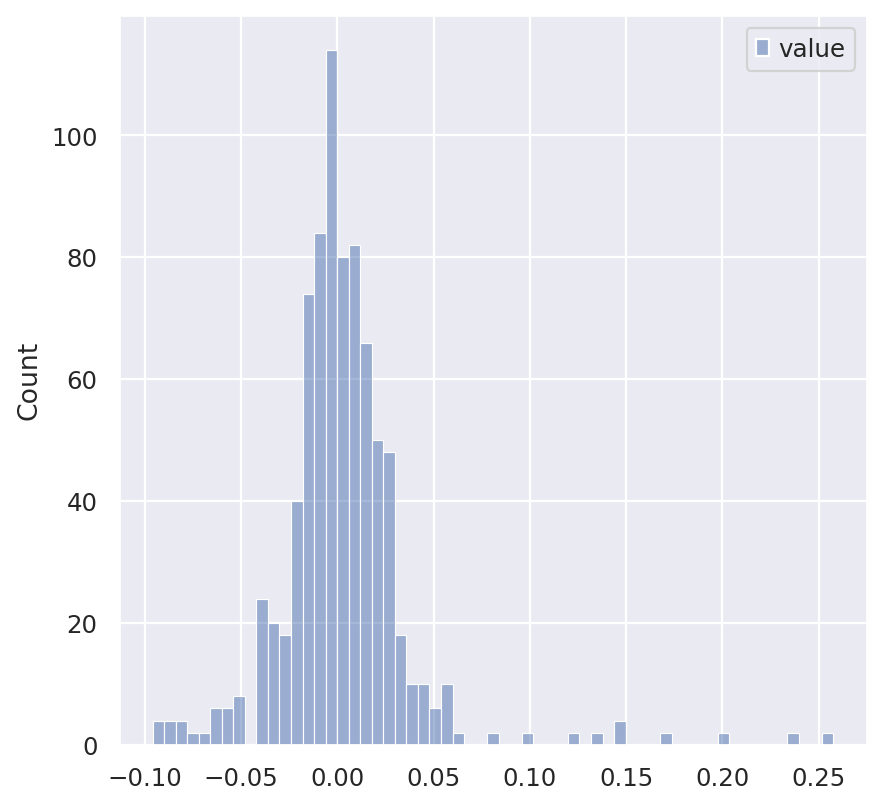

In [ ]:
hs = hotspot.Hotspot(
    orig_pixel_adata,
    layer_key=None,
    model='bernoulli',
    distances_obsp_key='dijkstra',
    umi_counts_obs_key="total_counts"
)
hs.create_knn_graph(weighted_graph=True, n_neighbors=15)
hs_pol = hs.compute_autocorrelations()
local_correlations = hs.compute_local_correlations(hs_pol.index)

long_coloc = hs.local_correlation_c.melt(ignore_index=False).rename(index={'marker':'marker_1'}, columns={'marker': 'marker_2'}).reset_index()
long_coloc = long_coloc[long_coloc['value'] != 0]
sns.histplot(long_coloc)
long_coloc['abs'] = np.abs(long_coloc['value'])
long_coloc.sort_values(by='abs', ascending=False).head(20)

In [ ]:
hs_pol

,C,Z,Pval,FDR
Gene,,,,
CD44,0.033419,3.621906,0.000146,0.010382
CD43,0.019309,1.770119,0.038354,0.230232
CD26,0.015124,1.741089,0.040834,0.230232
CD86,0.048462,1.672963,0.047167,0.230232
CD53,0.117036,1.667626,0.047695,0.230232
...,...,...,...,...
CD38,-0.004433,-0.499470,0.691276,0.732546
CD54,-0.009505,-1.054897,0.854264,0.883808
CD102,-0.011203,-1.075443,0.858912,0.883808


In [110]:
local_correlations

marker,CD127,CD162,CD8,CD50,CD2,CD11c,CD5,CD38,CD279,CD16,...,mIgG2a,CD11a,CD47,CD18,CD84,HLA-DR,mIgG2b,CD52,CD43,CD229
marker,,,,,,,,,,,,,,,,,,,,,
CD127,0.000000,-0.754291,1.406802,-0.407345,-0.290150,-0.568999,0.121997,-1.129050,1.168863,-0.518512,...,-0.212082,0.660112,0.243172,-0.973553,2.077745,0.299551,0.406681,0.877071,0.102781,0.348921
CD162,-0.754291,0.000000,-0.048604,-0.290027,1.983295,-0.375184,0.680411,0.665571,-1.453171,-1.209342,...,-0.439730,-0.054657,2.009841,-0.650882,0.806902,-1.427100,0.544284,0.516696,0.000579,-0.564896
CD8,1.406802,-0.048604,0.000000,-0.134427,-1.254410,-0.875810,-2.066209,-0.193708,-1.168739,0.826695,...,-1.484943,-1.146509,0.633676,0.955383,0.190610,0.470798,-0.304979,-0.172571,-1.106598,-0.567951
CD50,-0.407345,-0.290027,-0.134427,0.000000,-0.896376,-0.765815,-1.405248,0.667700,-0.677846,0.539328,...,-0.136054,2.983110,0.097656,-2.037265,0.501704,-0.016129,-0.519158,0.292254,-0.328869,-0.476919
CD2,-0.290150,1.983295,-1.254410,-0.896376,0.000000,-0.214562,0.403891,0.548194,-0.411878,-1.234875,...,0.705907,0.892657,0.292241,-0.485621,-0.647198,-0.097312,1.633154,0.671164,0.101814,0.646522
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
HLA-DR,0.299551,-1.427100,0.470798,-0.016129,-0.097312,1.700294,-0.543924,-1.347775,-0.521598,-0.133964,...,1.304969,-0.433618,-1.867571,-0.520072,-0.281398,0.000000,-1.837831,2.084785,0.652833,0.062244
mIgG2b,0.406681,0.544284,-0.304979,-0.519158,1.633154,-0.982577,0.662809,1.188427,-1.038107,-1.449075,...,0.729464,-1.535247,-0.752515,0.482537,-0.656303,-1.837831,0.000000,0.658819,-0.789447,1.123152
CD52,0.877071,0.516696,-0.172571,0.292254,0.671164,-0.882197,0.351677,-1.099020,0.025369,-1.387885,...,1.084099,0.980745,-0.363956,-1.744119,-1.753725,2.084785,0.658819,0.000000,0.514374,-1.160454


In [14]:
nbhd_size.value_counts().sort_index().head(20)

Count
3      5
4      4
5      5
6      6
7      6
8      7
9     16
10     4
11     7
12     9
13    10
14     7
15    10
16     8
17     4
18     8
19     2
20     7
21     8
22     5
Name: count, dtype: int64

<Axes: ylabel='Count'>

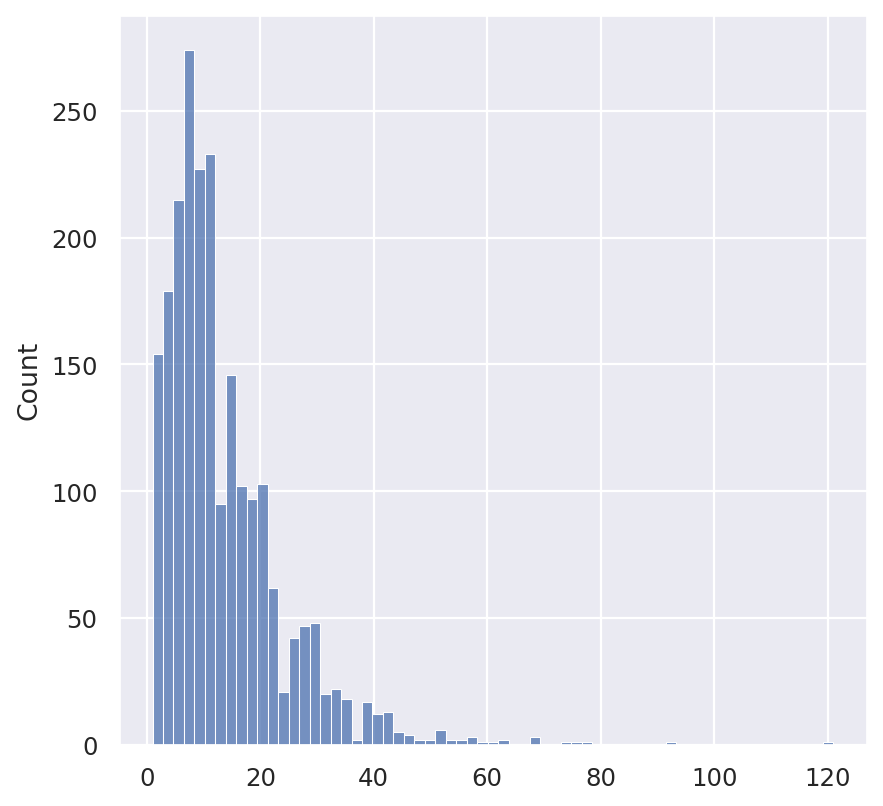

In [125]:
sns.histplot(g.dw)

In [115]:
np.array(pixel_size).reshape((1, -1)).repeat(C.shape[0], axis=0)

array([[ 8, 37,  1, ...,  1,  1,  1],
       [ 8, 37,  1, ...,  1,  1,  1],
       [ 8, 37,  1, ...,  1,  1,  1],
       ...,
       [ 8, 37,  1, ...,  1,  1,  1],
       [ 8, 37,  1, ...,  1,  1,  1],
       [ 8, 37,  1, ...,  1,  1,  1]])

In [ ]:
new_sizes.sum

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 0, ..., 0, 1, 0],
       [0, 0, 0, ..., 0, 0, 1]])

58     1
149    1
148    1
161    1
157    1
155    1
71     1
68     1
66     1
174    1
153    1
55     1
54     1
51     1
50     1
184    1
179    1
49     1
48     1
92     1
dtype: int64

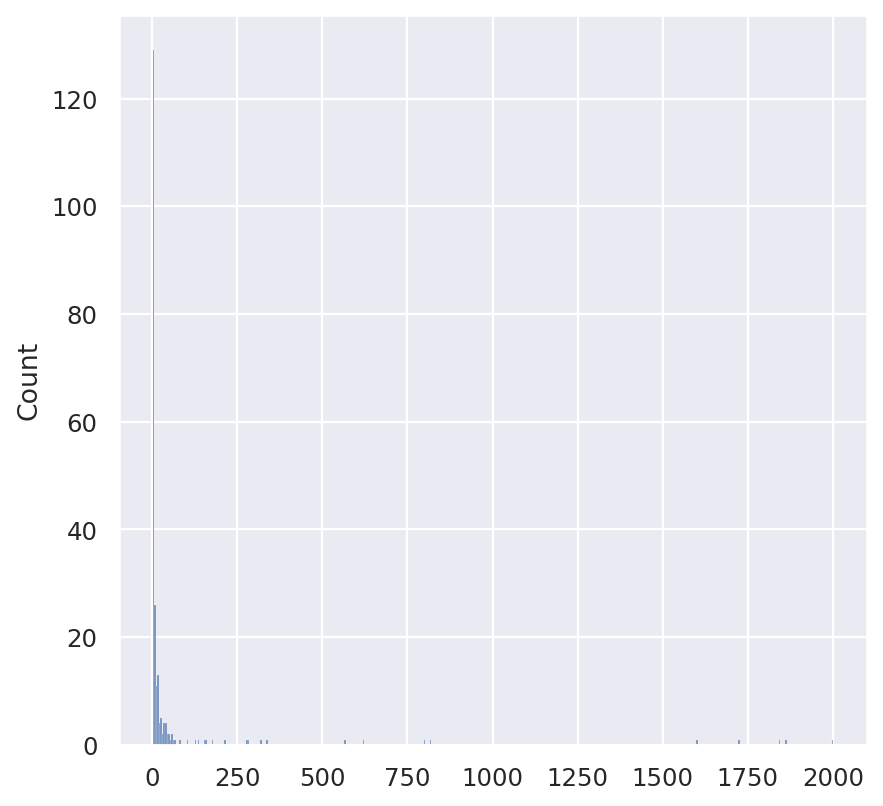

In [ ]:
from scipy.stats import pearsonr

size = (200,)
a = np.zeros(size, dtype=float)
a[0] = 0.1
a[1] = 0.1
b = np.random.normal(loc=0.3, scale=0.1, size=size)
pearsonr(a,b,)

In [ ]:
zip([str2pair(pair) for pair in highly_autocorr_pairs.index])

: 

: 

: 

NameError: name 'pd' is not defined

In [21]:
rantes_adata.obs.loc[comp, 'a_pixels'] + rantes_adata.obs.loc[comp, 'b_pixels']

1872

In [ ]:
edgelist = pg_data.edgelist
pixel_nbhd_counts = get_pixel_nbhd_counts(edgelist, rantes_adata, pixel_type='a', nbhd_radius=2, components=['RCVCMP0000067_sol_rantes'])

In [126]:
rantes_adata.to_df('counts').loc['RCVCMP0000067_sol_rantes', 'CD11c']

1

         m1      m2      corr            pair
840   CD162    CD37  0.752804    (CD162,CD37)
855   CD162    CD50  0.733326    (CD162,CD50)
3264   CD44    CD50  0.710094     (CD44,CD50)
2753   CD37    CD50  0.664492     (CD37,CD50)
847   CD162    CD44  0.654630    (CD162,CD44)
2745   CD37    CD44  0.640254     (CD37,CD44)
846   CD162    CD43  0.624529    (CD162,CD43)
2744   CD37    CD43  0.617728     (CD37,CD43)
3191   CD43    CD50  0.573450     (CD43,CD50)
3183   CD43    CD44  0.519520     (CD43,CD44)
2388   CD32    CD50  0.508014     (CD32,CD50)
305   CD11c    CD18  0.485563    (CD11c,CD18)
2380   CD32    CD44  0.473020     (CD32,CD44)
996    CD18  CD45RB  0.465678   (CD18,CD45RB)
2373   CD32    CD37  0.444882     (CD32,CD37)
2015  CD274    CD44  0.438208    (CD274,CD44)
4525   CD72  mIgG2b  0.434919   (CD72,mIgG2b)
2554  CD337  mIgG2b  0.395439  (CD337,mIgG2b)
341   CD11c    CD48  0.393147    (CD11c,CD48)
357   CD11c    CD86  0.383821    (CD11c,CD86)


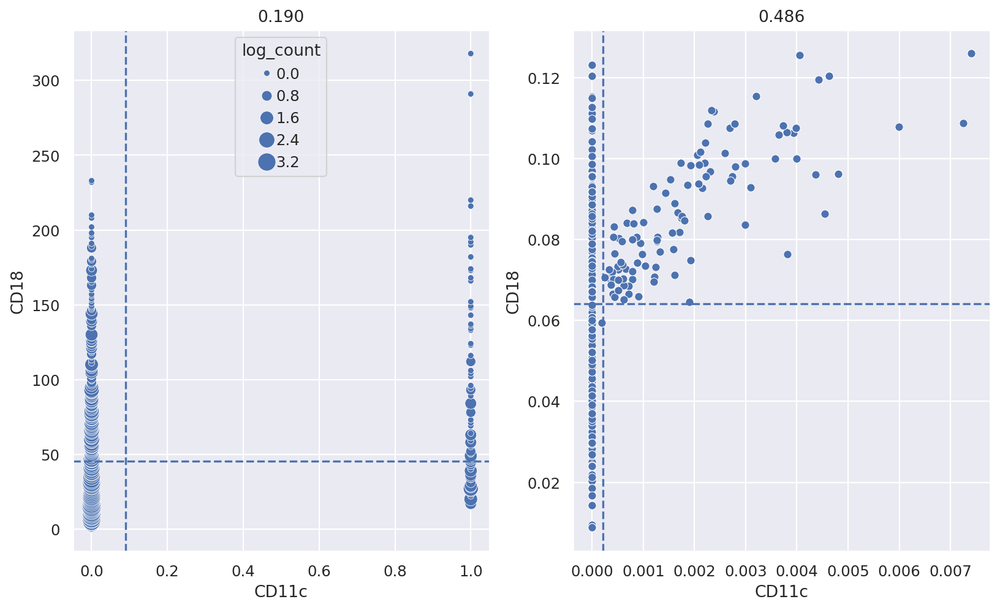

In [127]:
nbhd_counts = pixel_nbhd_counts['nbhd_counts'].pivot_table(index='nbhd_center_upi_int', columns='marker', values='Count', fill_value=0, observed=True).astype(int)
nbhd_total_counts = nbhd_counts.sum(axis=1)
large_nbhds = nbhd_total_counts[nbhd_total_counts > 100].index

nbhd_counts = nbhd_counts.loc[large_nbhds]
nbhd_means = nbhd_counts.mean(axis=0)

nbhd_counts_norm = nbhd_counts.div(nbhd_counts.sum(axis=1), axis=0)
nbhd_norm_means = nbhd_counts_norm.mean(axis=0)

nbhd_corr = nbhd_counts.corr()
nbhd_norm_corr = nbhd_counts_norm.corr()
nbhd_norm_corr_flat = flatten_corr(nbhd_norm_corr)
# sns.histplot(nbhd_norm_corr_flat)
print(nbhd_norm_corr_flat.sort_values(by='corr', ascending=False)[:20])

fig, ax = plt.subplots(1,2,figsize=(12,7))
# m1, m2 = 'CD162', 'CD37'
m1, m2 = 'CD11c', 'CD18'
# m1, m2 = 'CD162', 'CD50'
# m1, m2 = 'CD37', 'CD50'
# m1, m2 = 'B2M', 'HLA-DR'
df_agg = nbhd_counts.groupby([m1,m2]).size().reset_index(name='count')
df_agg['log_count'] = np.log(df_agg['count'])
# df_agg = df_agg[df_agg[m1] + df_agg[m2] > 0]


# Create a scatter plot where 'count' determines the marker size.
sns.scatterplot(data=df_agg, x=m1, y=m2, size='log_count', sizes=(20, 200), legend=True, ax=ax[0])
# sns.scatterplot(gld_a_counts,x='CD162',y='CD50', ax=ax[0])
sns.scatterplot(nbhd_counts_norm,x=m1,y=m2, ax=ax[1])
ax[0].set_title(f'{nbhd_corr.loc[m1,m2]:.3f}')
ax[1].set_title(f'{nbhd_norm_corr.loc[m1,m2]:.3f}')

for i, df in enumerate((nbhd_means, nbhd_norm_means)):
    ax[i].axhline(y=df[m2], linestyle='--')
    ax[i].axvline(x=df[m1], linestyle='--')

# print(len(large_nbhds) / len(nbhd_total_counts))
# sns.histplot(nbhd_total_counts, log_scale=True)

# pixel_nbhd_counts['nbhd_counts']

/tmp/ipykernel_1960594/3530775378.py:2: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  comp_pixel_counts = pd.pivot_table(pixel_counts[pixel_counts['component'] == comp], index='upi_int', columns='marker', values='Count').fillna(0).astype(int)


<Axes: xlabel='HLA-ABC', ylabel='Count'>

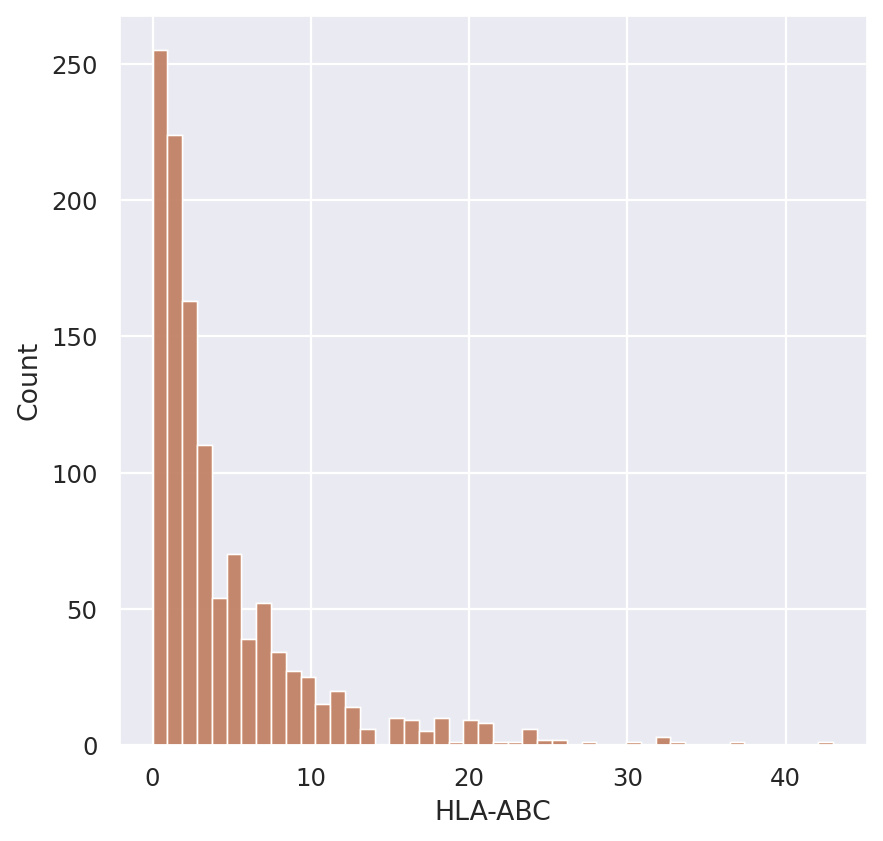

In [ ]:
comp = 'RCVCMP0000012_imm_rantes'
comp_pixel_counts = pd.pivot_table(pixel_counts[pixel_counts['component'] == comp], index='upi_int', columns='marker', values='Count').fillna(0).astype(int)

<Axes: xlabel='CD8', ylabel='Count'>

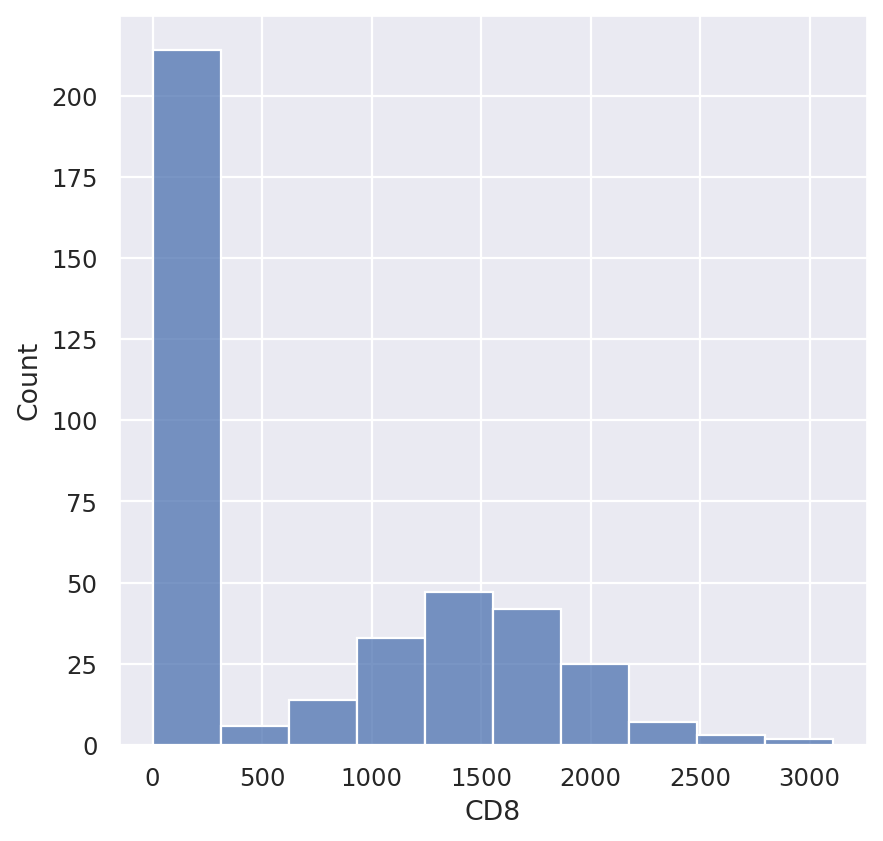

In [47]:
rantes_adata.to_df('counts')['CD8']

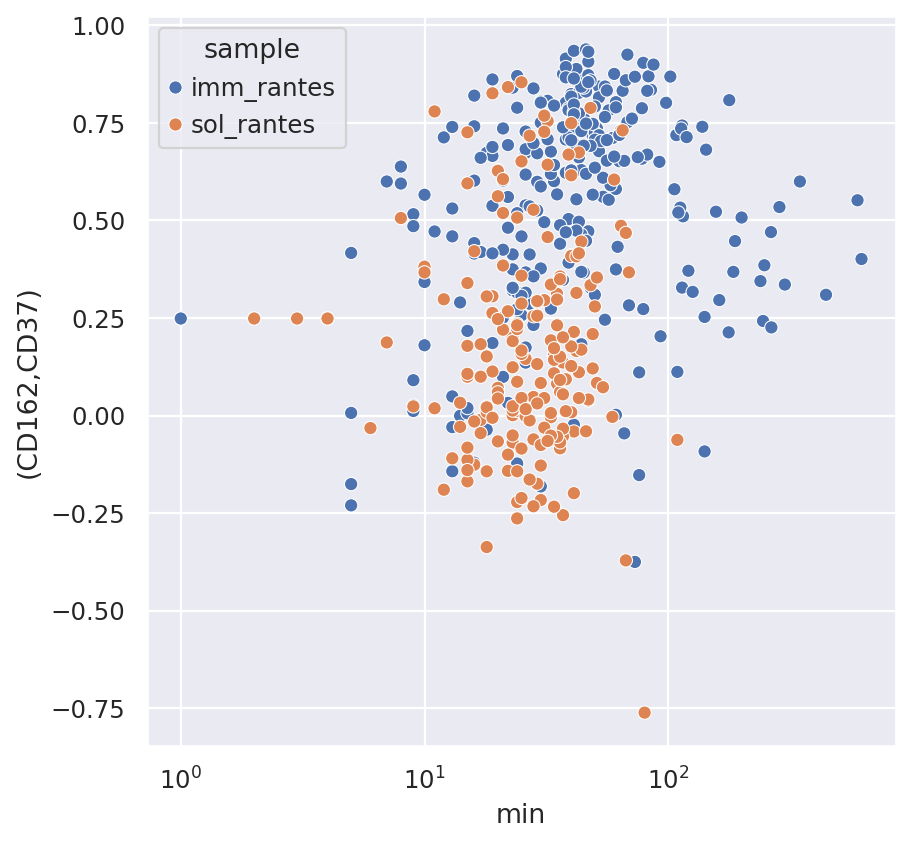

In [75]:
m1, m2 = 'CD162', 'CD37'
# m1, m2 = 'B2M', 'HLA-ABC'
pair = pair2str(m1, m2, sort=True)
counts_df = rantes_adata.to_df('counts')
min_counts = rantes_adata.to_df('counts').min(axis=0)
coloc_p_df = rantes_adata.obsm['coloc_p'].copy()
coloc_p_df['sample'] = rantes_adata.obs['sample']
coloc_p_df['min'] = np.minimum(counts_df[m1], counts_df[m2])
# sns.histplot(coloc_p_df, x=pair, hue='sample')
ax = sns.scatterplot(coloc_p_df, x='min', y=pair, hue='sample',)
ax.set_xscale('log')

RCVCMP0000067_sol_rantes 0.8540750036522617
0.507453013609851


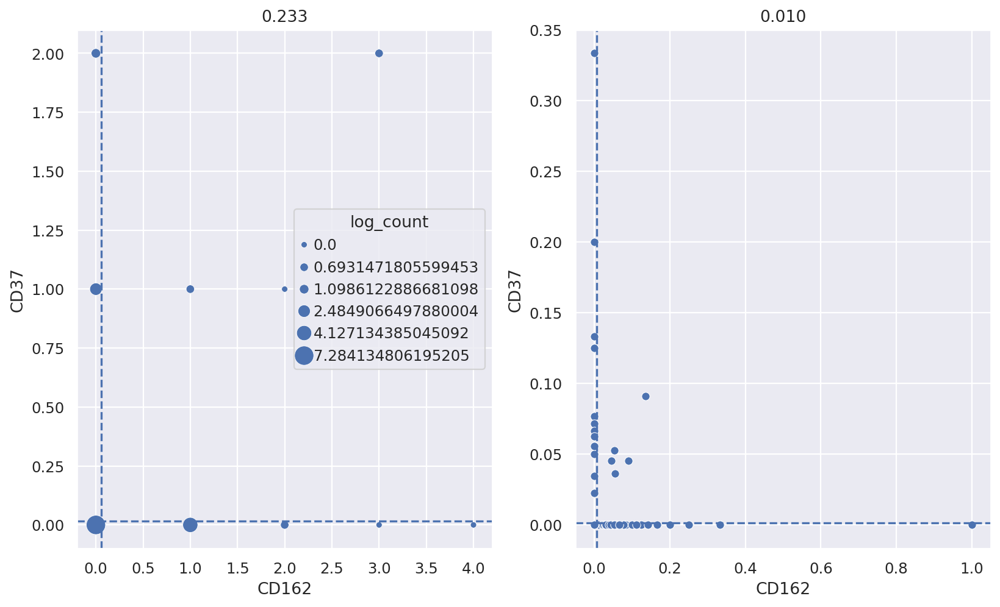

In [99]:
# comp = adata.obsm['coloc_p']['(B2M,HLA-ABC)'].sort_values(ascending=False).index[0]
m1, m2 = 'CD162', 'CD37'
pair = pair2str(m1,m2,sort=True)


comp = adata.obsm['coloc_p'].loc[adata.obs[adata.obs['sample'] == 'sol_rantes'].index][pair].sort_values(ascending=False).index[0]
# comp = 'RCVCMP0000012_imm_rantes'

print(comp, adata.obsm['coloc_p'].loc[comp, pair])

gld = compute_graph_layout(pg_data, comp)
gld_a = gld[gld['pixel_type'] == 'A']
# gld_a_counts.mean(axis=0).sort_values(ascending=False).head(20)
# gld_a_counts.corr('pearson')
# sns.scatterplot(gld_a_counts,x='B2M',y='HLA-ABC')
# gld_a_counts_norm = gld_a_counts / gld_a_counts.sum(axis=1)

gld_a_counts = gld_a.iloc[:,:77]
gld_a_pixel_sum = gld_a_counts.sum(axis=1)

# sns.histplot(gld_a_pixel_sum)

large_pixels = gld_a_pixel_sum[gld_a_pixel_sum > 5].index

print(len(large_pixels) / len(gld_a_pixel_sum))

# gld_a_counts = gld_a_counts.loc[large_pixels, :]



gld_a_counts_norm = gld_a_counts.div(gld_a_counts.sum(axis=1), axis=0)

gld_a_means = gld_a_counts.mean(axis=0)
gld_a_norm_means = gld_a_counts_norm.mean(axis=0)

corr = gld_a_counts.corr('pearson')
corr_norm = gld_a_counts_norm.corr('pearson')

def flatten_corr(corr):
    corr_flat = corr.stack().rename_axis(('m1','m2')).reset_index(name='corr')
    corr_flat = corr_flat[corr_flat['m1'] != corr_flat['m2']]
    corr_flat['pair'] = [pair2str(m1,m2,sort=True) for m1,m2 in zip(corr_flat['m1'], corr_flat['m2'])]
    corr_flat.drop_duplicates(subset='pair', inplace=True)
    return corr_flat

corr_flat = flatten_corr(corr)
corr_norm_flat = flatten_corr(corr_norm)

fig, ax = plt.subplots(1,2,figsize=(12,7))
# m1, m2 = 'CD162', 'CD37'
# m1, m2 = 'CD162', 'CD50'
# m1, m2 = 'CD37', 'CD50'
# m1, m2 = 'B2M', 'HLA-DR'
df_agg = gld_a_counts.groupby([m1,m2]).size().reset_index(name='count')
df_agg['log_count'] = np.log(df_agg['count'])
# df_agg = df_agg[df_agg[m1] + df_agg[m2] > 0]


# Create a scatter plot where 'count' determines the marker size.
sns.scatterplot(data=df_agg, x=m1, y=m2, size='log_count', sizes=(20, 200), legend=True, ax=ax[0])
# sns.scatterplot(gld_a_counts,x='CD162',y='CD50', ax=ax[0])
sns.scatterplot(gld_a_counts_norm,x=m1,y=m2, ax=ax[1])
ax[0].set_title(f'{corr.loc[m1,m2]:.3f}')
ax[1].set_title(f'{corr_norm.loc[m1,m2]:.3f}')

for i, df in enumerate((gld_a_means, gld_a_norm_means)):
    ax[i].axhline(y=df[m2], linestyle='--')
    ax[i].axvline(x=df[m1], linestyle='--')

In [ ]:
sns.histplot()

In [64]:
from sklearn.feature_selection import mutual_info_regression

def mutual_info(df, vars=None):
    if vars is None:
        vars = df.columns
    mutual_info_matrix = np.zeros((len(vars), len(vars)))

    for i, var1 in enumerate(vars):
        for j, var2 in enumerate(vars):
            X = df[[var1]]
            y = df[var2]
            mutual_info = mutual_info_regression(X, y)
            mutual_info_matrix[i, j] = mutual_info[0]

    mutual_info_df = pd.DataFrame(mutual_info_matrix, index=vars, columns=vars)

    return mutual_info_df    

In [67]:
# mutual_info_norm = mutual_info(gld_a_counts_norm)

0.3575168287210172
0.054055108629301366
0.0033148591401791793


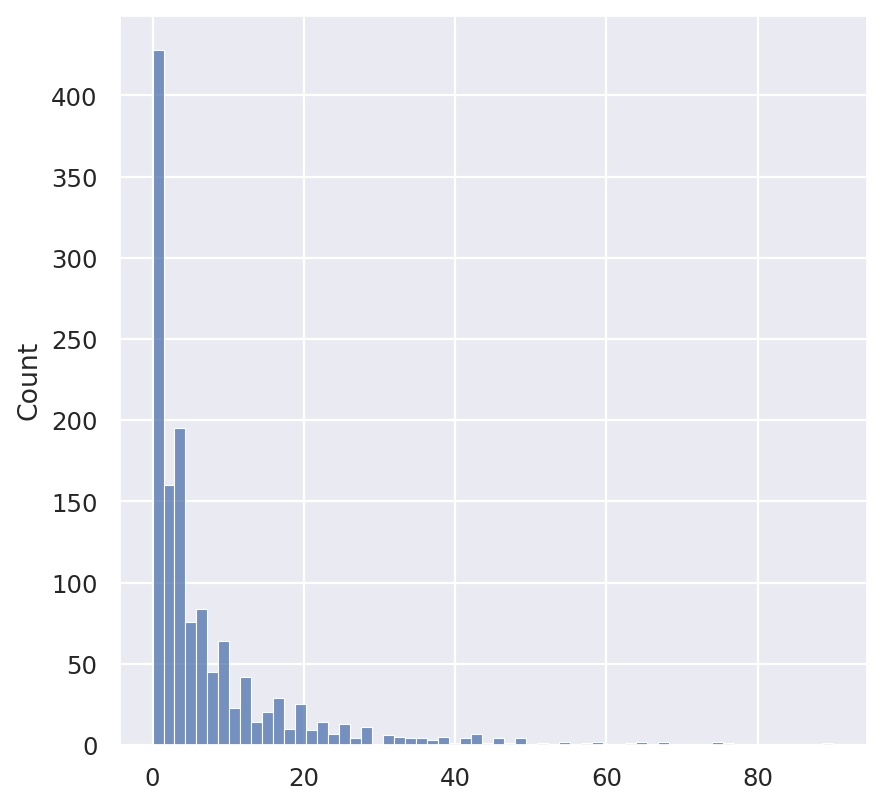

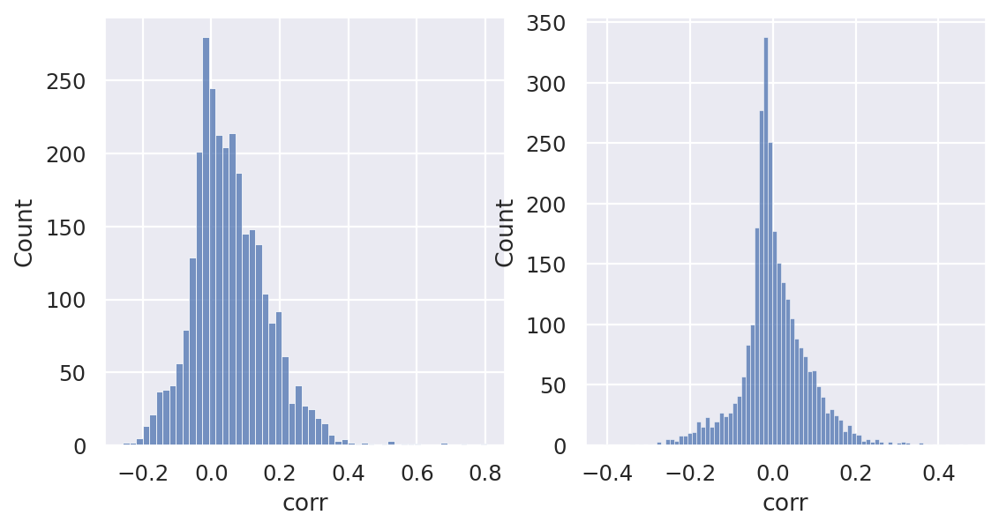

In [60]:
# sns.histplot(rantes_adata.to_df('counts')['CD162'])
# comp = rantes_adata.obs.index[100]
comp = adata.obsm['coloc_p']['(B2M,HLA-ABC)'].sort_values(ascending=False).index[0]
# print(rantes_adata.to_df('counts').loc[comp, 'CD162'])
gld = compute_graph_layout(pg_data, comp)
gld_a = gld[gld['pixel_type'] == 'A']
# gld_a_counts.mean(axis=0).sort_values(ascending=False).head(20)
# gld_a_counts.corr('pearson')
# sns.scatterplot(gld_a_counts,x='B2M',y='HLA-ABC')
# gld_a_counts_norm = gld_a_counts / gld_a_counts.sum(axis=1)

gld_a_counts = gld_a.iloc[:,:77]
gld_a_pixel_sum = gld_a_counts.sum(axis=1)

sns.histplot(gld_a_pixel_sum)

large_pixels = gld_a_pixel_sum[gld_a_pixel_sum > 5].index

print(len(large_pixels) / len(gld_a_pixel_sum))

gld_a_counts = gld_a_counts.loc[large_pixels, :]



gld_a_counts_norm = gld_a_counts.div(gld_a_counts.sum(axis=1), axis=0)

gld_a_means = gld_a_counts.mean(axis=0)
gld_a_norm_means = gld_a_counts_norm.mean(axis=0)





corr = gld_a_counts.corr('pearson')
corr_norm = gld_a_counts_norm.corr('pearson')

def flatten_corr(corr):
    corr_flat = corr.stack().rename_axis(('m1','m2')).reset_index(name='corr')
    corr_flat = corr_flat[corr_flat['m1'] != corr_flat['m2']]
    corr_flat['pair'] = [pair2str(m1,m2,sort=True) for m1,m2 in zip(corr_flat['m1'], corr_flat['m2'])]
    corr_flat.drop_duplicates(subset='pair', inplace=True)
    return corr_flat

corr_flat = flatten_corr(corr)
corr_norm_flat = flatten_corr(corr_norm)

# print(corr_flat)

fig, ax = plt.subplots(1,2,figsize=(8,4))
sns.histplot(corr_flat['corr'], ax=ax[0])
sns.histplot(corr_norm_flat['corr'], ax=ax[1])

print(corr_flat['corr'].mean())
print(corr_norm_flat['corr'].mean())

# markers = corr.columns
# coloc_comp = []
# index = []
# for m1 in markers:
#     for m2 in markers:
#         if m2 <= m1:
#             continue
#         coloc_comp.append(corr.loc[m1,m2])
#         index.append(pair2str(m1,m2,sort=True))
# coloc_comp = pd.Series(coloc_comp, index=index)
# sns.histplot(coloc_comp)
# coloc_comp['(CD162,CD50)']
# sns.scatterplot(gld_a_counts_norm,x='B2M',y='HLA-DR')




In [12]:
autocorr = distr_autocorrelation_in_latent(rantes_adata, latent_neighbors_connectivities_key_lst=['multi_model_coloc_connectivities'], 
                                           names=['Multi Model (Coloc Latent)'], distr_key='coloc_p_unit')
highly_autocorr_pairs = autocorr.sort_values(by='morans', ascending=False)
m1, m2 = zip(*[str2pair(pair) for pair in highly_autocorr_pairs.index])
highly_autocorr_pairs['m1'] = m1
highly_autocorr_pairs['m2'] = m2
# # for pair in highly_autocorr_pairs.index:
# #     m1, m2 = str2pair(pair)
# #     highly_autocorr_pairs['m1'] = m1
# #     highly_autocorr_pairs['m2'] = m2
highly_autocorr_pairs['m1_mean'] = highly_autocorr_pairs['m1'].map(rantes_adata.to_df('counts').mean(axis=0))
highly_autocorr_pairs['m2_mean'] = highly_autocorr_pairs['m2'].map(rantes_adata.to_df('counts').mean(axis=0))

print(highly_autocorr_pairs.head(20))

                   morans    gearys                      latent     m1  \
(CD162,CD50)     0.666743  0.350598  Multi Model (Coloc Latent)  CD162   
(CD162,CD37)     0.643095  0.354515  Multi Model (Coloc Latent)  CD162   
(CD37,CD50)      0.637319  0.341304  Multi Model (Coloc Latent)   CD37   
(CD162,CD44)     0.516930  0.468253  Multi Model (Coloc Latent)  CD162   
(CD44,CD50)      0.512497  0.457954  Multi Model (Coloc Latent)   CD44   
(CD18,CD50)      0.507135  0.478654  Multi Model (Coloc Latent)   CD18   
(CD37,CD44)      0.497977  0.474156  Multi Model (Coloc Latent)   CD37   
(CD162,CD18)     0.482227  0.519669  Multi Model (Coloc Latent)  CD162   
(CD18,CD37)      0.474713  0.520908  Multi Model (Coloc Latent)   CD18   
(CD50,HLA-ABC)   0.455955  0.502771  Multi Model (Coloc Latent)   CD50   
(CD11a,CD19)     0.435903  0.428351  Multi Model (Coloc Latent)  CD11a   
(CD19,CD40)      0.428000  0.454487  Multi Model (Coloc Latent)   CD19   
(CD11b,CD337)    0.419775  0.516143  M

In [ ]:
compute_graph_layout(pg_data, )

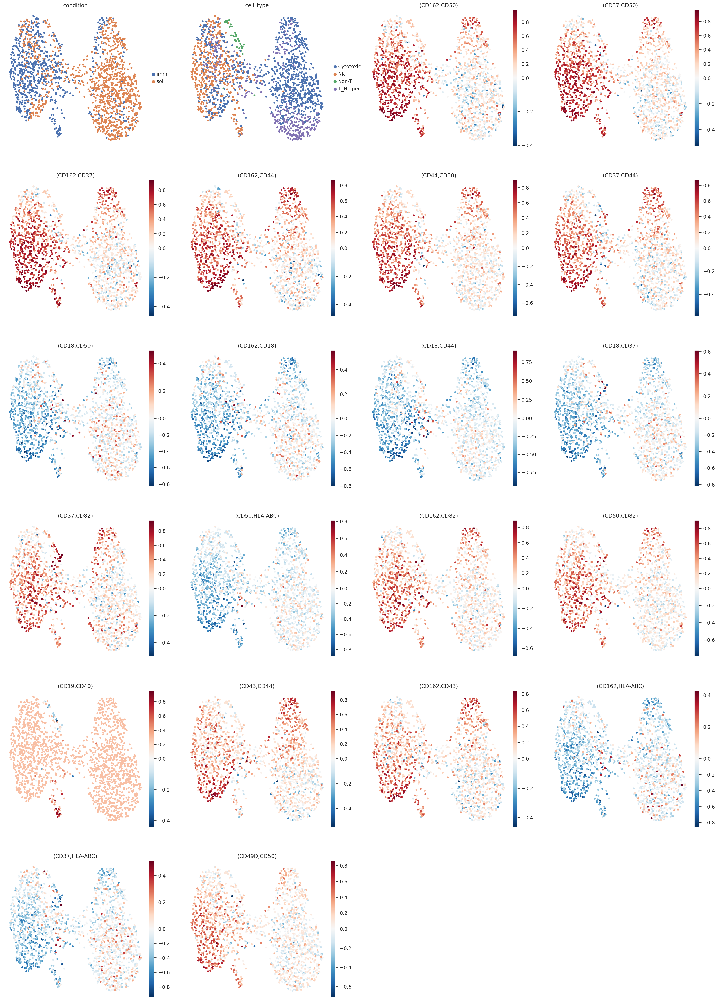

In [83]:
autocorr = distr_autocorrelation_in_latent(adata, latent_neighbors_connectivities_key_lst=['multi_model_coloc_connectivities'], 
                                           names=['Multi Model (Coloc Latent)'], distr_key='coloc_p_unit')
highly_autocorr_pairs = list(autocorr.sort_values(by='morans', ascending=False)[0:20].index)
for pair in highly_autocorr_pairs:
    # adata.obs[pair] = adata.obsm['coloc_p'][pair]
    ada

# fig = pca_neighbors_umap(adata, latent_name, umap_pl_kwargs=dict(color=['sample', 'cell_type', *highly_autocorr_pairs], vcenter=0, cmap='RdBu_r'), )

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 200 records. Best score: 80.476. Signaling Trainer to stop.


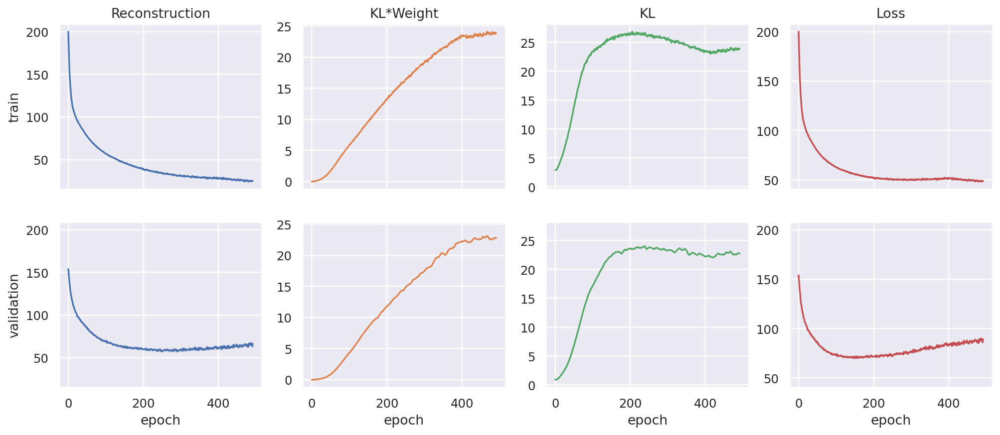

In [17]:
EPOCHS = 10000
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=2000, n_epochs_kl_warmup=400, lr=1e-3,
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(optimizer='Adam'))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, prior_mixture=False)
model_cls = CytoVI
model_cls.setup_anndata(adata, layer='dsb', batch_key='sample',)
model = model_cls(adata, **model_kwargs)
model.train(**train_kwargs)
ax = plot_losses(model,)

In [18]:
polarization = convert_polarization_to_feature_matrix(pg_data.polarization, components=adata.obs.index, key='morans_i', fill_na_with_mean=True)
# polarization = np.log1p(polarization)
adata.obsm['polarization_morans_i'] = polarization.reindex(adata.obs.index)
polarization = adata.obsm['polarization_morans_i']
adata.obs['CD162_pol'] = adata.obsm['polarization_morans_i']['CD162_pol']
adata.obsm['polarization_morans_i']

,ACTB_pol,B2M_pol,CD102_pol,CD11a_pol,CD11b_pol,CD11c_pol,CD127_pol,CD137_pol,CD14_pol,CD150_pol,...,CD82_pol,CD84_pol,CD86_pol,CD9_pol,HLA-ABC_pol,HLA-DR_pol,TCRVb5_pol,mIgG1_pol,mIgG2a_pol,mIgG2b_pol
component,,,,,,,,,,,,,,,,,,,,,
RCVCMP0000012_imm_rantes,0.041592,-0.015353,-0.003729,-0.006783,0.013447,-0.009634,0.004143,0.030859,0.048798,-0.000451,...,0.008261,0.007894,-0.003623,0.030321,-0.029365,-0.017168,-0.009841,0.006880,-0.004233,-0.003420
RCVCMP0000013_imm_rantes,0.031865,0.088864,0.012725,0.028231,0.004943,0.016342,0.008538,0.014973,0.041452,0.007539,...,0.048534,0.003433,0.054577,0.023241,0.112942,0.189797,0.002530,0.002693,0.003327,0.008250
RCVCMP0000018_imm_rantes,0.018778,0.106305,-0.011280,-0.010683,0.013447,0.097657,0.116950,0.030859,0.149549,0.020461,...,0.032200,0.008348,0.001210,0.030321,0.085089,0.062718,0.087174,0.006880,-0.005200,-0.005730
RCVCMP0000020_imm_rantes,0.084649,0.193289,0.011483,-0.002505,0.027488,0.020582,0.023251,0.037301,0.035482,0.028799,...,0.001438,0.015594,-0.002651,0.055438,0.359677,0.037842,0.005275,0.012067,0.015399,0.010423
RCVCMP0000021_imm_rantes,0.212704,0.128088,0.033653,0.114082,0.082606,0.132631,0.150013,0.030859,0.139659,0.145829,...,0.060347,0.240261,0.019910,0.123492,0.174178,0.063315,0.330841,0.101395,0.065154,0.111031
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
RCVCMP0000511_sol_rantes,0.041592,-0.006234,0.007111,-0.001005,0.013447,0.008031,-0.015191,0.030859,0.048798,0.020461,...,-0.000444,-0.002203,0.002615,0.030321,-0.004344,0.011635,0.004638,0.006880,-0.003292,0.002092
RCVCMP0000536_sol_rantes,0.041592,-0.001259,0.006264,0.012733,0.013447,0.008031,-0.001774,0.030859,0.048798,0.020461,...,0.006992,0.027112,0.003794,-0.006139,-0.017669,0.015095,0.004638,0.006880,0.003200,-0.003592
RCVCMP0000547_sol_rantes,0.041592,0.004280,0.001613,-0.016979,0.013447,0.008031,-0.007220,0.030859,0.048798,0.020461,...,-0.004580,0.002366,0.005904,0.030321,-0.010732,0.000795,-0.005605,0.006880,0.002963,0.002092


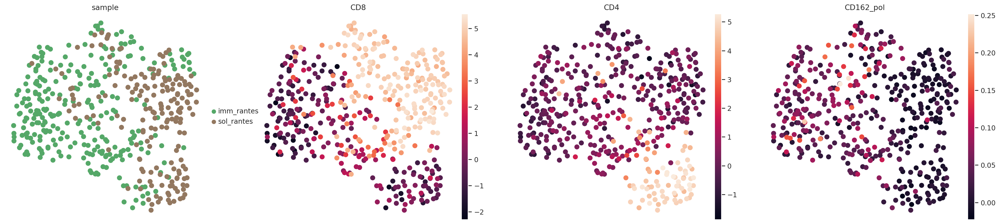

In [19]:
adata.obsm['model_latent'] = model.get_latent_representation()
sc.pp.neighbors(adata, use_rep='model_latent', key_added='model_latent')
sc.tl.umap(adata, neighbors_key='model_latent')
sc.pl.umap(adata, layer='dsb', color=['sample', 'CD8', 'CD4', 'CD162_pol'])

In [20]:
joint_df = pd.concat((adata.to_df('dsb'), polarization), axis=1)
# joint_df = center_feature_matrix(joint_df) 
joint_adata = anndata.AnnData(
    X=joint_df,
    obs=adata.obs
)
pol_adata = anndata.AnnData(
    X=polarization,
    obs=adata.obs
)
joint_adata.to_df()

,B2M,CD102,CD11a,CD11b,CD11c,CD127,CD137,CD14,CD150,CD152,...,CD82_pol,CD84_pol,CD86_pol,CD9_pol,HLA-ABC_pol,HLA-DR_pol,TCRVb5_pol,mIgG1_pol,mIgG2a_pol,mIgG2b_pol
component,,,,,,,,,,,,,,,,,,,,,
RCVCMP0000012_imm_rantes,0.217435,-0.023725,-1.091946,0.436238,0.641175,0.397161,0.218168,0.625346,1.389450,0.966076,...,0.008261,0.007894,-0.003623,0.030321,-0.029365,-0.017168,-0.009841,0.006880,-0.004233,-0.003420
RCVCMP0000013_imm_rantes,1.322622,2.098635,2.224566,-0.063806,0.475942,1.309431,-0.095579,-0.143379,-0.167313,0.378149,...,0.048534,0.003433,0.054577,0.023241,0.112942,0.189797,0.002530,0.002693,0.003327,0.008250
RCVCMP0000018_imm_rantes,0.280743,-0.388274,0.158085,0.912124,0.744083,0.914994,1.095528,1.829137,0.651945,0.714511,...,0.032200,0.008348,0.001210,0.030321,0.085089,0.062718,0.087174,0.006880,-0.005200,-0.005730
RCVCMP0000020_imm_rantes,0.185710,0.551910,1.919032,1.147919,0.915591,2.087785,1.312298,1.262899,0.471278,0.457130,...,0.001438,0.015594,-0.002651,0.055438,0.359677,0.037842,0.005275,0.012067,0.015399,0.010423
RCVCMP0000021_imm_rantes,0.193985,-0.070187,0.700470,0.887372,1.206676,0.321251,0.003316,1.342488,0.688384,1.863046,...,0.060347,0.240261,0.019910,0.123492,0.174178,0.063315,0.330841,0.101395,0.065154,0.111031
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
RCVCMP0000511_sol_rantes,0.010078,0.721854,2.792248,0.375776,-0.309205,1.879095,0.602572,1.108908,0.911159,-0.362726,...,-0.000444,-0.002203,0.002615,0.030321,-0.004344,0.011635,0.004638,0.006880,-0.003292,0.002092
RCVCMP0000536_sol_rantes,0.092828,0.572489,2.981829,-0.746559,0.230919,2.113833,-0.568778,-0.185795,-0.326864,-0.711840,...,0.006992,0.027112,0.003794,-0.006139,-0.017669,0.015095,0.004638,0.006880,0.003200,-0.003592
RCVCMP0000547_sol_rantes,0.182790,0.334625,3.469486,0.630735,0.607404,2.685848,0.886648,0.773116,1.234843,0.943278,...,-0.004580,0.002366,0.005904,0.030321,-0.010732,0.000795,-0.005605,0.006880,0.002963,0.002092


In [ ]:
scvi.model.MULTIVI

INFO     Using column names from columns of adata.obsm['polarization_morans_i']                                    


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 200 records. Best score: -89.230. Signaling Trainer to stop.


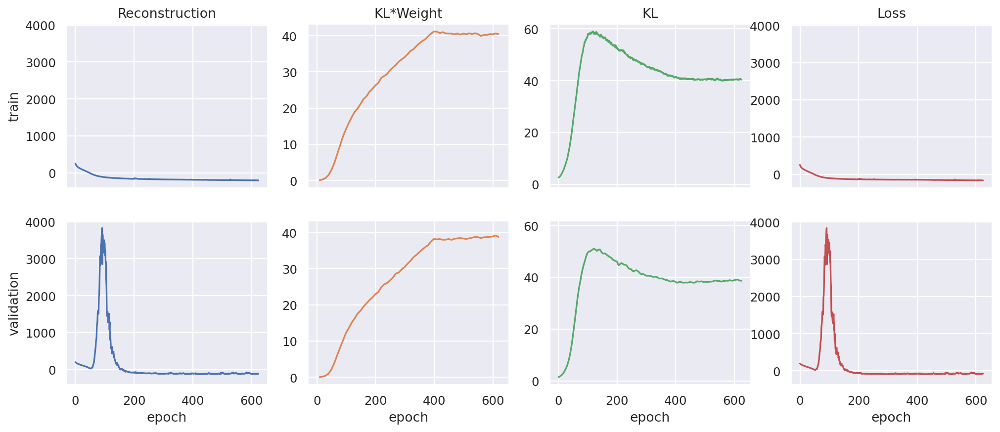

In [36]:
EPOCHS = 10000

obsm_extra_modality_keys=['polarization_morans_i']

model_cls = NormalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=1000, 
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(optimizer='Adam', n_epochs_kl_warmup=400, lr=1e-3,))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, n_extra_modalities=1, obsm_extra_modality_keys=obsm_extra_modality_keys, weights=[0.9, 0.1])
model_cls.setup_anndata(adata, layer='dsb', batch_key='sample', obsm_extra_modality_keys=obsm_extra_modality_keys)
multi_model = model_cls(adata, **model_kwargs)
# print(normal_joint_model)
multi_model.train(**train_kwargs)
ax = plot_losses(multi_model)

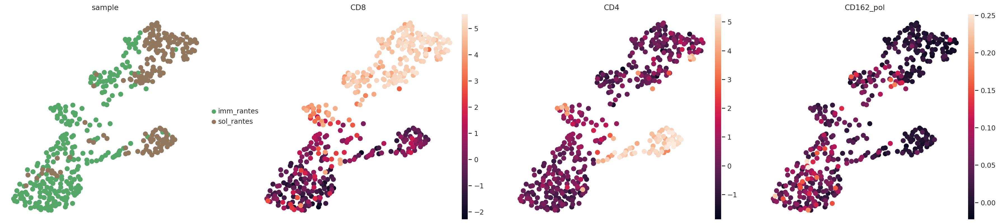

In [37]:
adata.obsm['multi_model_latent'] = multi_model.get_latent_representation()
sc.pp.neighbors(adata, use_rep='multi_model_latent', key_added='multi_model_latent')
sc.tl.umap(adata, neighbors_key='multi_model_latent')
sc.pl.umap(adata, layer='dsb', color=['sample', 'CD8', 'CD4', 'CD162_pol'])

Normal SCVI Model with the following params: 
n_latent: 20
n_extra_modalities: 0
weights: tensor([1.], dtype=torch.float64)
input_ds: [160]
Training status: Not Trained

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 200 records. Best score: -100.866. Signaling Trainer to stop.


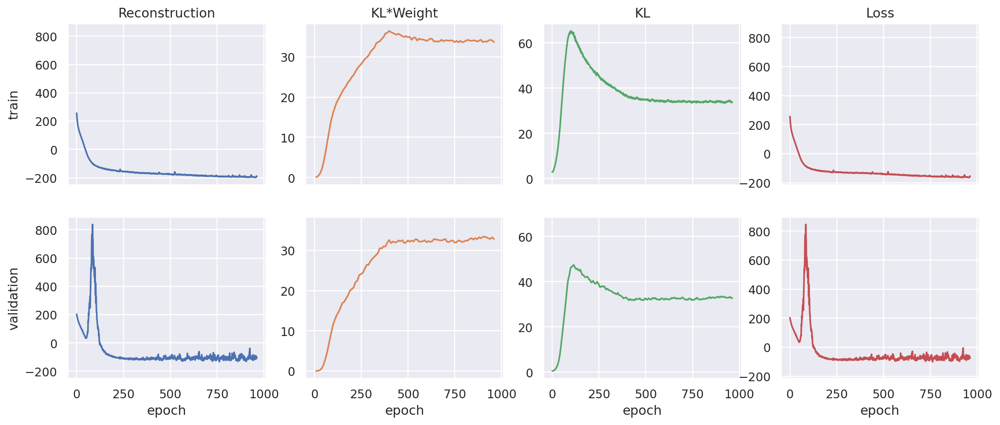

In [185]:
EPOCHS = 10000

# model_cls = CytoVI
# train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=1000, n_epochs_kl_warmup=400, lr=1e-3,
#                     max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(optimizer='Adam'))
# model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, prior_mixture=False)
# model_cls.setup_anndata(joint_adata, batch_key='sample',)
# cyto_joint_model = model_cls(joint_adata, **model_kwargs)
# cyto_joint_model.train(**train_kwargs)
# ax = plot_losses(cyto_joint_model)


model_cls = NormalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=1000, 
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(optimizer='Adam', n_epochs_kl_warmup=400, lr=1e-3,))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1)
model_cls.setup_anndata(joint_adata, batch_key='sample',)
normal_joint_model = model_cls(joint_adata, **model_kwargs)
print(normal_joint_model)
normal_joint_model.train(**train_kwargs)
ax = plot_losses(normal_joint_model)

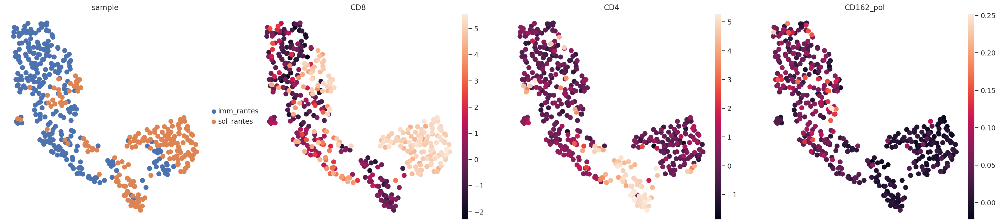

In [186]:
# joint_adata.obsm['cyto_model_latent'] = cyto_joint_model.get_latent_representation()
# sc.pp.neighbors(joint_adata, use_rep='cyto_model_latent', key_added='cyto_model_latent')
# sc.tl.umap(joint_adata, neighbors_key='cyto_model_latent')
# # joint_adata.obs.drop(columns='CD162_pol', inplace=True)
# sc.pl.umap(joint_adata, color=['sample', 'CD8', 'CD4', 'CD162_pol'])

joint_adata.obsm['normal_model_latent'] = normal_joint_model.get_latent_representation()
sc.pp.neighbors(joint_adata, use_rep='normal_model_latent', key_added='normal_model_latent')
sc.tl.umap(joint_adata, neighbors_key='normal_model_latent')
# joint_adata.obs.drop(columns='CD162_pol', inplace=True)
sc.pl.umap(joint_adata, color=['sample', 'CD8', 'CD4', 'CD162_pol'])

## Latent space concatenation

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 20 records. Best score: -164.997. Signaling Trainer to stop.


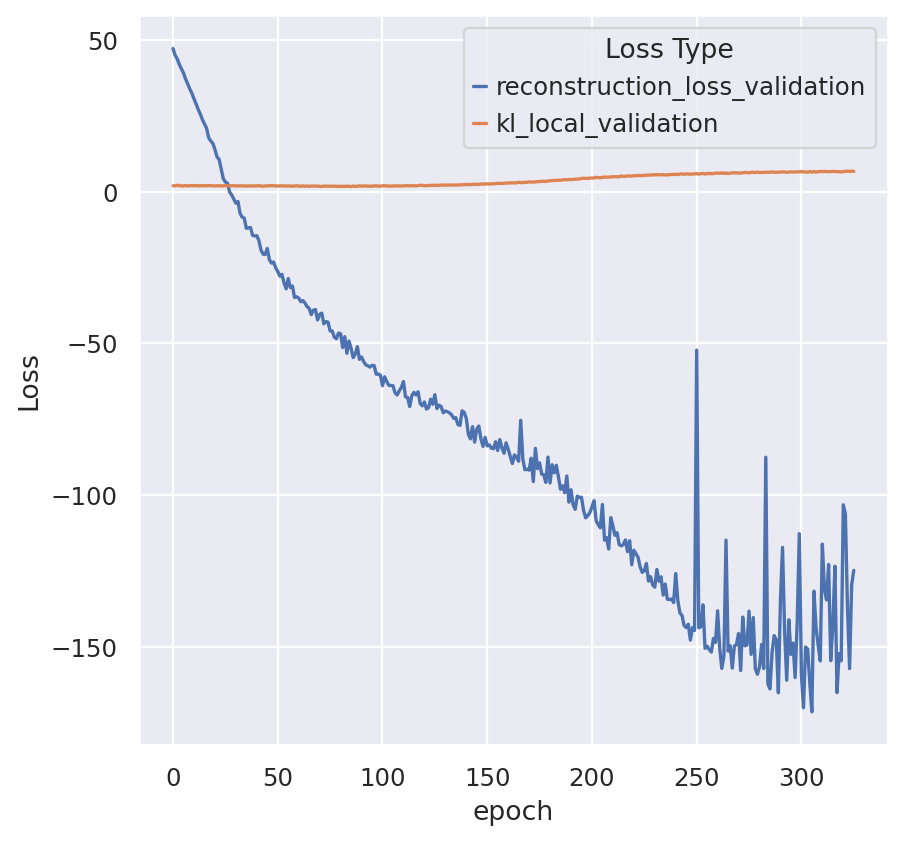

In [19]:
EPOCHS = 10000
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=20, batch_size=1000,
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(lr=3e-4, optimizer='Adam', n_epochs_kl_warmup=0))
model_kwargs = dict(n_latent=10, n_hidden=128, n_layers=1, dropout_rate=0.1, prior_mixture=True)
model_cls.setup_anndata(pol_adata, batch_key='sample',)
pol_model = model_cls(pol_adata, **model_kwargs)
pol_model.train(**train_kwargs)
ax = plot_validation_loss(pol_model, semilogy=False)

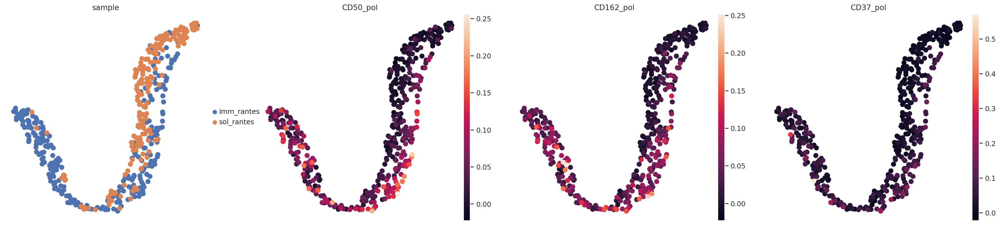

In [21]:
pol_adata.obsm['model_latent'] = pol_model.get_latent_representation()
sc.pp.neighbors(pol_adata, use_rep='model_latent', key_added='model_latent')
sc.tl.umap(pol_adata, neighbors_key='model_latent')
pol_adata.obs.drop(columns='CD162_pol', inplace=True)
sc.pl.umap(pol_adata, color=['sample', 'CD50_pol', 'CD162_pol', 'CD37_pol'])

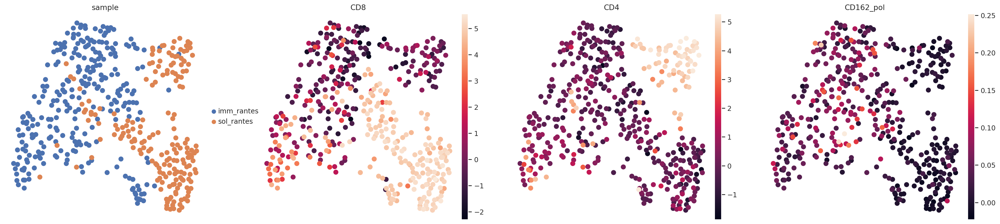

In [23]:
adata.obsm['concat_latent'] = np.concatenate((adata.obsm['model_latent'], pol_adata.obsm['model_latent']), axis=1)
sc.pp.neighbors(adata, use_rep='concat_latent', key_added='concat_latent')
sc.tl.umap(adata, neighbors_key='concat_latent')
sc.pl.umap(adata, layer='dsb', color=['sample', 'CD8', 'CD4', 'CD162_pol'])

In [211]:
joint_adata.layers['decoded'] = joint_model.get_normalized_expression()

In [212]:
sc.tl.rank_genes_groups(joint_adata, groupby='sample', layer='decoded', use_raw=False, method='wilcoxon')
joint_de = sc.get.rank_genes_groups_df(joint_adata, group='imm_rantes', pval_cutoff=0.05)
# sc.pl.rank_genes_groups_dotplot(joint_adata, n_genes=10, values_to_plot="pvals_adj", )
signficant_de = joint_de['names']
polarized_significant_markers = [m.split('_')[0] for m in signficant_de if 'pol' in m]
significant_markers = [m for m in signficant_de if 'pol' not in m]
print(len(polarized_significant_markers))
print(len(significant_markers))
print(sorted(list(set(polarized_significant_markers).intersection(set(significant_markers)))))
print(sorted(list(set(polarized_significant_markers).difference(set(significant_markers)))))


60
64
['CD102', 'CD11b', 'CD11c', 'CD127', 'CD154', 'CD16', 'CD161', 'CD162', 'CD163', 'CD18', 'CD197', 'CD20', 'CD22', 'CD244', 'CD25', 'CD26', 'CD27', 'CD274', 'CD278', 'CD32', 'CD328', 'CD36', 'CD37', 'CD4', 'CD40', 'CD45RA', 'CD47', 'CD48', 'CD49D', 'CD50', 'CD52', 'CD53', 'CD54', 'CD55', 'CD59', 'CD7', 'CD72', 'CD8', 'CD82', 'CD86', 'HLA-ABC', 'HLA-DR', 'TCRVb5', 'mIgG1', 'mIgG2a', 'mIgG2b']
['ACTB', 'B2M', 'CD14', 'CD2', 'CD200', 'CD229', 'CD279', 'CD337', 'CD35', 'CD38', 'CD41', 'CD62P', 'CD71', 'CD84']


/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(


In [ ]:
components_to_keep = pg_data_combined_pxl_object.adata[
    (pg_data_combined_pxl_object.adata.obs["molecules"] >= 10000)
    & (pg_data_combined_pxl_object.adata.obs["tau_type"] == "normal")
].obs.index

pg_data_combined_pxl_object.filter(components=components_to_keep).save(DATA_DIR/ "combined_data_filtered.pxl", force_overwrite=True)

In [ ]:
sc.tl.rank_genes_groups(adata, groupby='sample', layer='log1p', use_raw=False, method='wilcoxon')
sc.pl.rank_genes_groups_dotplot(adata, n_genes=10, values_to_plot="logfoldchanges", cmap='bwr',)